In [3]:
import typing
import io
import os

import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
import random

from urllib.request import urlretrieve

from PIL import Image
from torchvision import transforms

from models.modeling_seg import ActiveTestVisionTransformer, CONFIGS

from utils.data_utils_feature import FeatureDataset

def np_read(file):
    with open(file, "rb") as outfile:
        data = np.load(outfile)
    return data

/home/sas20048/anaconda/envs/at_det/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
%%capture
config = CONFIGS["ViT-B_16"]
config.input_feature_dim = 25
config.loss_range = "all"
config.region_size = 16
config.ordinal_class_num = 50
config.model_data_type = "PSPNet_VOC"
steps = 20000
model = ActiveTestVisionTransformer(config, num_classes=50, zero_head=False, img_size=480, vis=True)
model_checkpoint = f"./output/ViT_{config.model_data_type}_all_checkpoint_{steps}.bin"
model.load_state_dict(torch.load(model_checkpoint))
model.eval()

In [5]:
## choose one data
import torch.nn.functional as F
def np_read_with_tensor_output(file):
    with open(file, "rb") as outfile:
        data = np.load(outfile)
    return torch.from_numpy(data.astype(np.float32))

split = "val"
model_data_path = f"/data/active_testing/active_testing_seg/pytorch-segmentation/pro_data/{config.model_data_type}/"
feature_dir = model_data_path + split + "/feature/"
image_dir = model_data_path + split + "/image/"
loss_dir = model_data_path + split + "/loss/"
annotation_dir = model_data_path + split + "/image_true_losses.npy"
target_dir = model_data_path + split + "/target/"
inputs_path = model_data_path + split
entropy_dir = model_data_path + split + "/entropy/"

train_loader = FeatureDataset(inputs_path, annotation_dir, config, aug=False)
avgpool = torch.nn.AdaptiveAvgPool2d((30,30))

# def display_image(index, image_name):
#     from PIL import Image
#     import matplotlib.pyplot as plt

#     # Open the image
#     image_path = "/data/active_testing/active_testing_seg/datasets/PascalVOC/VOCdevkit/VOC2012/JPEGImages/" + image_name # Replace with the actual image path
#     image = Image.open(image_path)
    
#     base_size = 480
#     longside = random.randint(int(base_size*0.5), int(base_size*2.0))
#     h, w = (longside, int(1.0 * longside * w / h + 0.5)) if h > w else (int(1.0 * longside * h / w + 0.5), longside)
#     image = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)

#     # Display the image using matplotlib
#     plt.imshow(image)
#     plt.axis('off')  # Turn off axes
#     plt.show()

def display_image(index, image_name, save = False):
    from PIL import Image
    import matplotlib.pyplot as plt

    # Open the image
    image_path = "/data/active_testing/active_testing_seg/datasets/PascalVOC/VOCdevkit/VOC2012/JPEGImages/" + image_name # Replace with the actual image path
    # image = Image.open(image_path)
    image = np.asarray(Image.open(image_path), dtype=np.float32)
    
    crop_size = 480
    h, w = image.shape[:2]
    # Scale the smaller side to crop size
    if h < w:
        h, w = (crop_size, int(crop_size * w / h))
    else:
        h, w = (int(crop_size * h / w), crop_size)

    image = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)

    # Center Crop
    h, w = image.shape[:2]
    start_h = (h - crop_size )// 2
    start_w = (w - crop_size )// 2
    end_h = start_h + crop_size
    end_w = start_w + crop_size
    image = image[start_h:end_h, start_w:end_w]

    # Display the image using matplotlib
    plt.imshow(image.astype(np.uint8))
    plt.axis('off')  # Turn off axes
    if save:
        plt.savefig(f'./figure/loss_output_entropy_figures/{index}_image.png', bbox_inches='tight', pad_inches=0)
    plt.show()

def get_image_name_by_index(index):
    file_list = "/data/active_testing/active_testing_seg/datasets/PascalVOC/VOCdevkit/VOC2012/ImageSets/Segmentation/" + split + ".txt"
    image_list = [name.rstrip() for name in tuple(open(file_list, "r"))]
    return image_list[index] + ".jpg"

def display_ground_truth_mask(index, save=False):
    file_name = str(index//8) + ".npy"
    image_index = index % 8
    one_target = np_read_with_tensor_output(target_dir + file_name)
    target = one_target[image_index]
    target[target==255] = 0
    print("Ground Truth")
    plt.matshow(target)
    plt.axis('off')
    if save:
        plt.savefig(f'./figure/{index}_gt.png', bbox_inches='tight', pad_inches=0)
    # plt.colorbar()
    plt.show()
    return target
    
def display_target_output_and_gt(index, save=False):
    file_name = str(index) + ".npy"
    target = np_read_with_tensor_output(feature_dir + file_name)
    target = np.argmax(target, axis=0)
    gt = display_ground_truth_mask(index)
    # max_index = np.unravel_index(gt.argmax(), gt.shape)
    # target = target / target[max_index] * gt.max()
    target[target==target.max()] = gt.max()
    print("Output from target model")
    plt.matshow(target)
    plt.axis('off')
    if save:
        plt.savefig(f'./figure/loss_output_entropy_figures/{index}_target_output.png', bbox_inches='tight', pad_inches=0)
    # plt.colorbar()
    plt.show()
    
    entropy = np_read(entropy_dir + str(index//8) + ".npy")
    entropy = entropy[index%8]
    print("Entropy from target model")
    plt.matshow(entropy[0])
    plt.axis('off')
    if save:
        plt.savefig(f'./figure/loss_output_entropy_figures/{index}_entropy.png', bbox_inches='tight', pad_inches=0)
    # plt.colorbar()
    plt.show()
    
def display_target_image(index):
    file_name = str(index//8) + ".npy"
    image_index = index % 8
    one_target = np_read_with_tensor_output(image_dir + file_name)
    target = one_target[image_index]
    plt.imshow(np.transpose(target, (1, 2, 0)))  # Transpose the array to (480, 480, 3) for RGB format
    plt.axis('off')  # Turn off axis for the plot
    plt.show()

## Get Attention Figure

In [78]:
from scipy.stats import norm
def attention_display(index, save = False):
    image_name = get_image_name_by_index(index)

    file_name = str(index//8) + ".npy"
    image_index = index % 8
    feature, label = train_loader.__getitem__(index)
    x, att_mat = model.transformer(feature.unsqueeze(0))
    # logits, att_mat, patch_estimates = model(feature.unsqueeze(0))
    att_mat = torch.stack(att_mat).squeeze(1)

    losses = np_read(loss_dir + file_name)[image_index]
    
    
    print("Region 16x16 losses")
    region_losses = torch.from_numpy(losses).unsqueeze(0)
    region_losses = avgpool(region_losses).numpy().squeeze()
    plt.matshow(region_losses)
    plt.axis('off')
    # plt.colorbar()
    if save:
        plt.savefig(f'./figure/attention/{index}_att_patch_losses.png', bbox_inches='tight', pad_inches=0)
    plt.show()

    # Average the attention weights across all heads.
    att_mat = torch.mean(att_mat, dim=1)

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1))
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)

     # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size())
    joint_attentions[0] = aug_att_mat[0]

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])

    # Attention from the output token to the input space.
    v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()

    image_path = "/data/active_testing/active_testing_seg/datasets/PascalVOC/VOCdevkit/VOC2012/JPEGImages/" + image_name

    image = np.asarray(Image.open(image_path), dtype=np.float32)

    crop_size = 480
    h, w = image.shape[:2]
    # Scale the smaller side to crop size
    if h < w:
        h, w = (crop_size, int(crop_size * w / h))
    else:
        h, w = (int(crop_size * h / w), crop_size)

    image = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)

    # Center Crop
    h, w = image.shape[:2]
    start_h = (h - crop_size )// 2
    start_w = (w - crop_size )// 2
    end_h = start_h + crop_size
    end_w = start_w + crop_size
    image = image[start_h:end_h, start_w:end_w]
 
    # new_mask = mask
    # new_mask = new_mask / new_mask.max()
    # plt.matshow(new_mask)
    # plt.axis('off')
    # if save:
    #     plt.savefig(f'./figure/attention/{index}_attention.png', bbox_inches='tight', pad_inches=0)
    # plt.show()

    l1_mask = joint_attentions[1, 0, 1:].reshape(grid_size, grid_size).detach().numpy()
    l1_mask = l1_mask / l1_mask.max()
    
    l2_mask = joint_attentions[2, 0, 1:].reshape(grid_size, grid_size).detach().numpy()
    l2_mask = l2_mask / l2_mask.max()
    
    new_mask = np.repeat(np.repeat(l2_mask, 16, axis=0), 16, axis=1)[:, :, np.newaxis]
    new_mask[new_mask > 0.2] = 1
    result = (new_mask * image).astype("uint8")
    plt.imshow(result)
    plt.axis('off')  # Turn off axes
    if save:
        plt.savefig(f'./figure/attention/{index}_image_attention.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    
    
    # plt.matshow(l1_mask)
    # plt.axis('off')
    # if save:
    #     plt.savefig(f'./figure/attention/{index}_l1_attention.png', bbox_inches='tight', pad_inches=0)
    # plt.show()
    
    # Display the image using matplotlib
    plt.imshow(image.astype(np.uint8))
    plt.axis('off')  # Turn off axes
    if save:
        plt.savefig(f'./figure/attention/{index}_att_image.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    
    print("All losses")
    plt.matshow(losses)
    plt.axis('off')
    # plt.colorbar()
    if save:
        plt.savefig(f'./figure/attention/{index}_att_all_losses.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    
    plt.matshow(l2_mask)
    plt.axis('off')
    if save:
        plt.savefig(f'./figure/attention/{index}_attention.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    

Region 16x16 losses


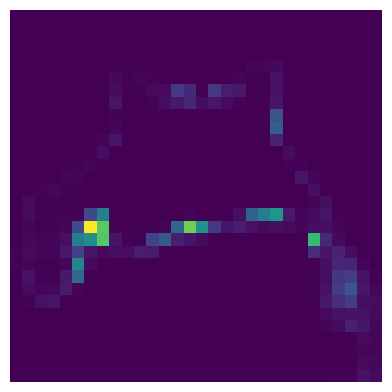

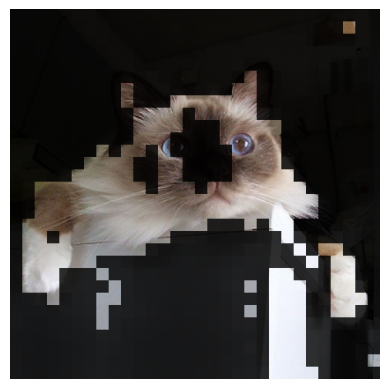

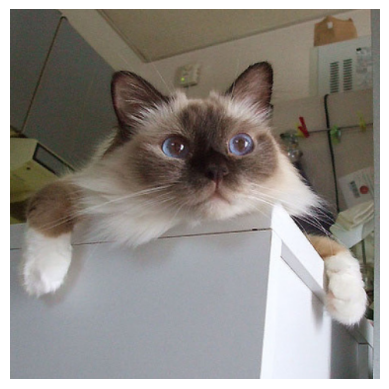

All losses


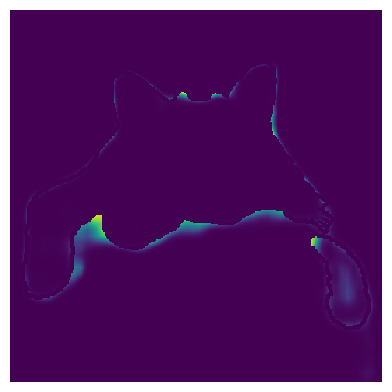

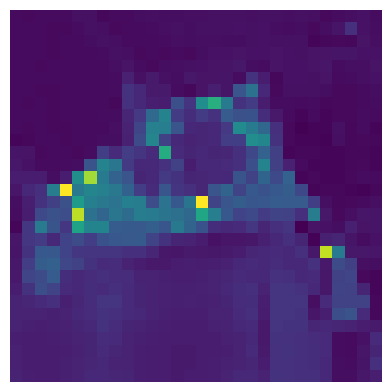

In [83]:
# 430, 330, 323, 776
#New: 632 (0.15), 603(0.2), 771(0.1), 785(0.1),792(0.2),794(0.2)
attention_display(794, True)

All losses


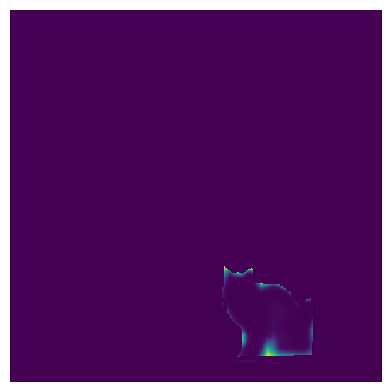

Region 16x16 losses


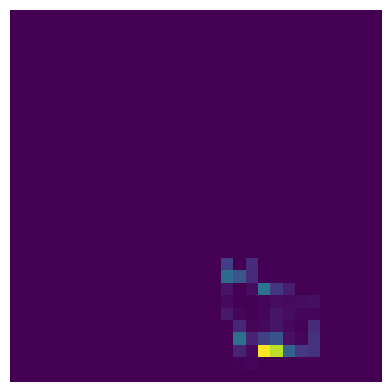

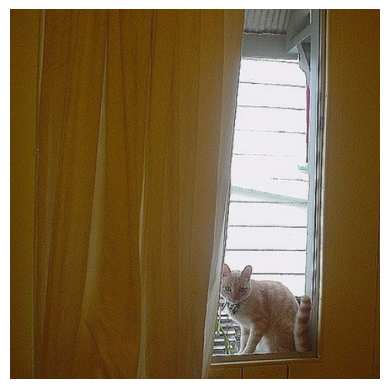

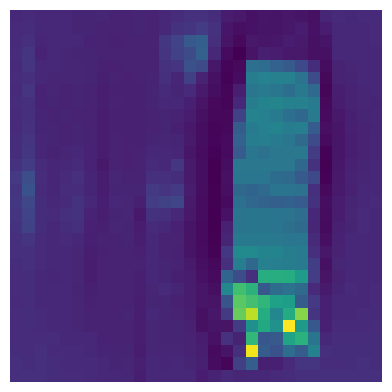

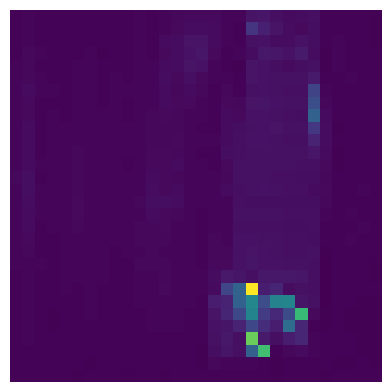

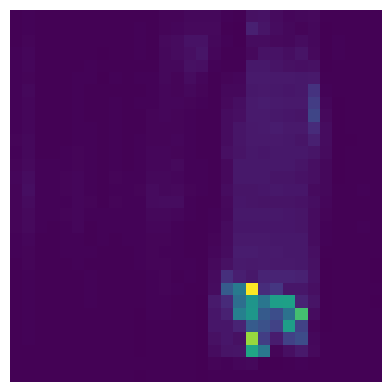

In [40]:
# 430, 330, 323, 776
attention_display(330, True)

## For attention

In [26]:
from scipy.stats import norm
def attention_display(index, save = False):
    image_name = get_image_name_by_index(index)

    file_name = str(index//8) + ".npy"
    image_index = index % 8
    feature, label = train_loader.__getitem__(index)
    x, att_mat = model.transformer(feature.unsqueeze(0))
    # logits, att_mat, patch_estimates = model(feature.unsqueeze(0))
    att_mat = torch.stack(att_mat).squeeze(1)

    losses = np_read(loss_dir + file_name)[image_index]
    # print("All losses")
    # plt.matshow(losses)
    # plt.axis('off')
    # # plt.colorbar()
    # if save:
    #     plt.savefig(f'./figure/{index}_att_losses.png', bbox_inches='tight', pad_inches=0)
    # plt.show()
    
    print("Region 16x16 losses")
    region_losses = torch.from_numpy(losses).unsqueeze(0)
    region_losses = avgpool(region_losses).numpy().squeeze()
    # plt.matshow(region_losses, cmap='gray')
    # plt.axis('off')
    # # plt.colorbar()
    # if save:
    #     plt.savefig(f'./figure/{index}_patch_losses.png', bbox_inches='tight', pad_inches=0)
    # plt.show()

    # Average the attention weights across all heads.
    att_mat = torch.mean(att_mat, dim=1)

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1))
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)

     # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size())
    joint_attentions[0] = aug_att_mat[0]

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])

    # Attention from the output token to the input space.
    v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()

    image_path = "/data/active_testing/active_testing_seg/datasets/PascalVOC/VOCdevkit/VOC2012/JPEGImages/" + image_name

    image = np.asarray(Image.open(image_path), dtype=np.float32)

    crop_size = 480
    h, w = image.shape[:2]
    # Scale the smaller side to crop size
    if h < w:
        h, w = (crop_size, int(crop_size * w / h))
    else:
        h, w = (int(crop_size * h / w), crop_size)

    image = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)

    # Center Crop
    h, w = image.shape[:2]
    start_h = (h - crop_size )// 2
    start_w = (w - crop_size )// 2
    end_h = start_h + crop_size
    end_w = start_w + crop_size
    image = image[start_h:end_h, start_w:end_w]

    # Display the image using matplotlib
    plt.imshow(image.astype(np.uint8))
    plt.axis('off')  # Turn off axes
    if save:
        plt.savefig(f'./figure/{index}_att_image.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    
    new_mask = mask
    # new_mask = new_mask - new_mask.min()
    new_mask = new_mask / new_mask.max()
    # plt.matshow(new_mask)
    # plt.axis('off')
    # # plt.colorbar()
    # if save:
    #     plt.savefig(f'./figure/{index}_attention.png', bbox_inches='tight', pad_inches=0)
    # plt.show()
    
#     new_mask = np.repeat(np.repeat(new_mask, 16, axis=0), 16, axis=1)[:, :, np.newaxis]
#     new_mask = new_mask - new_mask.min()
#     new_mask = new_mask / new_mask.max()
#     result = (new_mask * image).astype("uint8")

#     plt.imshow(result)
#     plt.axis('off')  # Turn off axes
#     if save:
#         plt.savefig(f'./figure/{index}_attention.png', bbox_inches='tight', pad_inches=0)
#     plt.show()
    
    # for i, v in enumerate(joint_attentions):
    #     # Attention from the output token to the input space.
    #     mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()
    #     mask = mask/mask.max()
    #     print('Attention Map_%d Layer' % (i+1))
    #     plt.matshow(mask, cmap='gray', vmin=0, vmax=1)
    #     plt.axis('off')
    #     # plt.colorbar()
    #     plt.show()
        
#     max_index = region_losses.argmax()
#     print(max_index)
#     consider_matrix = np.zeros(900)
#     consider_matrix[max_index] = 1
#     consider_matrix = consider_matrix.reshape((30,30))
    
#     max_region_mask = v[max_index + 1, 1:].reshape(grid_size, grid_size).detach().numpy()
#     # max_region_mask = max_region_mask - max_region_mask.min()
#     max_region_mask = max_region_mask / max_region_mask.max()
#     print(np.abs(max_region_mask - new_mask).sum(), max_region_mask.shape)
    
    
#     fig, axs = plt.subplots(2, 2, figsize=(8, 8))
#     axs[0, 0].matshow(region_losses, cmap='gray', vmin=0, vmax=1)
#     axs[0, 0].set_title('Region losses')

#     axs[0, 1].matshow(new_mask, cmap='gray', vmin=0, vmax=1)
#     axs[0, 1].set_title('Image Attention')

#     axs[1, 0].matshow(consider_matrix, cmap='gray', vmin=0, vmax=1)
#     axs[1, 0].set_title('The considered region')

#     axs[1, 1].matshow(max_region_mask, cmap='gray', vmin=0, vmax=1)
#     axs[1, 1].set_title('Attention for the region')

    l1_mask = joint_attentions[1, 0, 1:].reshape(grid_size, grid_size).detach().numpy()
    l1_mask = l1_mask / l1_mask.max()
    
    l2_mask = joint_attentions[2, 0, 1:].reshape(grid_size, grid_size).detach().numpy()
    l2_mask = l2_mask / l2_mask.max()

    fig, axs = plt.subplots(2, 2, figsize=(8, 8))
    axs[0, 0].matshow(region_losses, vmin=0, vmax=1)
    axs[0, 0].set_title('Region losses')

    axs[0, 1].matshow(new_mask, vmin=0, vmax=1)
    axs[0, 1].set_title('Image Attention')

    axs[1, 0].matshow(l1_mask, vmin=0, vmax=1)
    axs[1, 0].set_title('Attention for Layer 1')

    axs[1, 1].matshow(l2_mask, vmin=0, vmax=1)
    axs[1, 1].set_title('Attention for Layer 2')
    
    for ax in axs.flat:
        plt.colorbar(ax.images[0], ax=ax).remove()
        ax.set_xticks([])
        ax.set_yticks([])
    plt.tight_layout()
    plt.show()

In [5]:
min_value = 0
min_index = -1
index_list = []

start_index = 750
for index in range(start_index, start_index+50):
    image_name = get_image_name_by_index(index)

    file_name = str(index//8) + ".npy"
    image_index = index % 8
    feature, label = train_loader.__getitem__(index)
    x, att_mat = model.transformer(feature.unsqueeze(0))
    # logits, att_mat, patch_estimates = model(feature.unsqueeze(0))
    att_mat = torch.stack(att_mat).squeeze(1)

    losses = np_read(loss_dir + file_name)[image_index]
    
    region_losses = torch.from_numpy(losses).unsqueeze(0)
    region_losses = avgpool(region_losses).numpy().squeeze()
    region_losses = region_losses / region_losses.max()
    
    att_mat = torch.mean(att_mat, dim=1)

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1))
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)

     # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size())
    joint_attentions[0] = aug_att_mat[0]

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])

    # Attention from the output token to the input space.
    # v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    # mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()
    mask = joint_attentions[2, 0, 1:].reshape(grid_size, grid_size).detach().numpy()
    
    new_mask = mask
    new_mask = new_mask / new_mask.max()
    
    # diff = np.abs(new_mask - region_losses).sum()
    # diff = np.abs(new_mask[new_mask>0.1] - region_losses[new_mask>0.1]).mean()
    # if diff < min_value:
    #     min_value = diff
    #     min_index = index
    # if index % 100 == 0:
    #     print(index)
    
    diff = np.logical_and(region_losses>0.2,  new_mask>0.2).sum() / (region_losses>0.2).sum()
    if diff > min_value:
        min_value = diff
        min_index = index
    if diff >= 1.0:
        index_list.append(index)
    

In [6]:
min_value, min_index, index_list

(0.9933333333333333, 769, [])

Region 16x16 losses


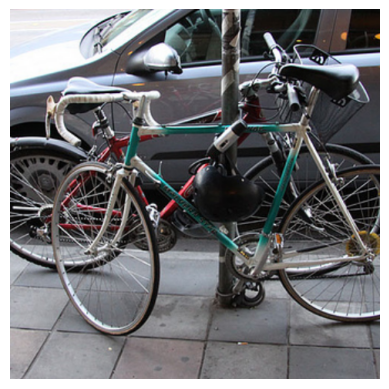

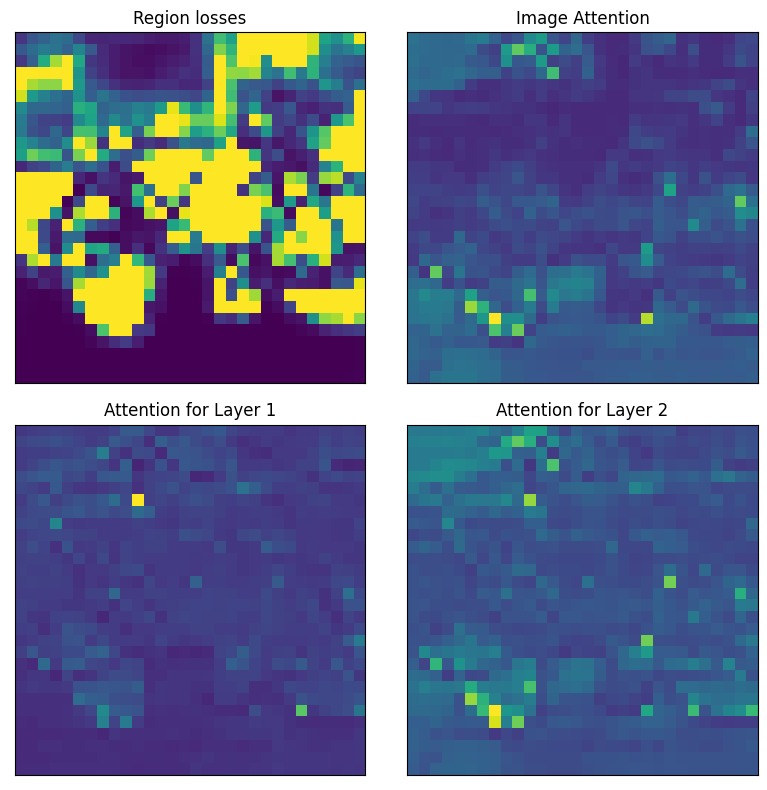

In [27]:
attention_display(708)

All losses


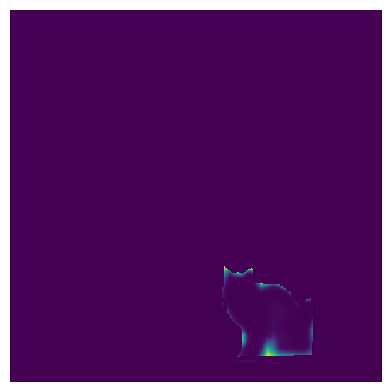

Region 16x16 losses


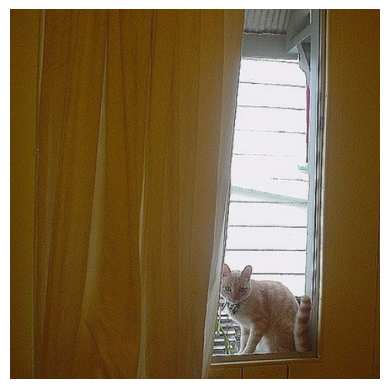

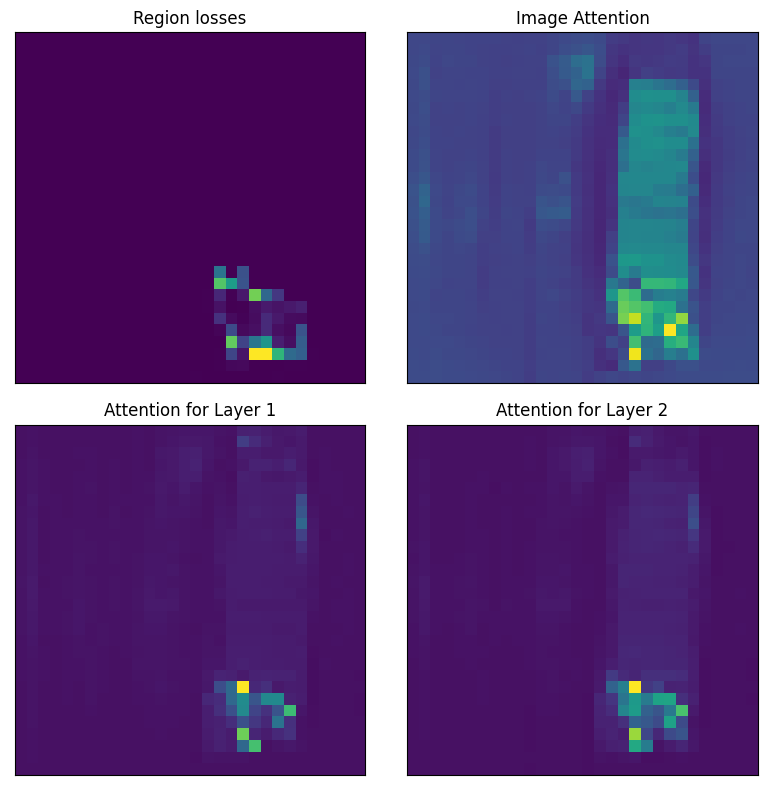

In [21]:
attention_display(330)

All losses


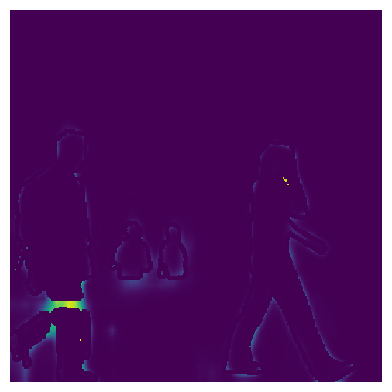

Region 16x16 losses


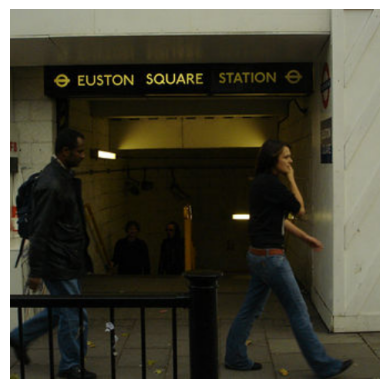

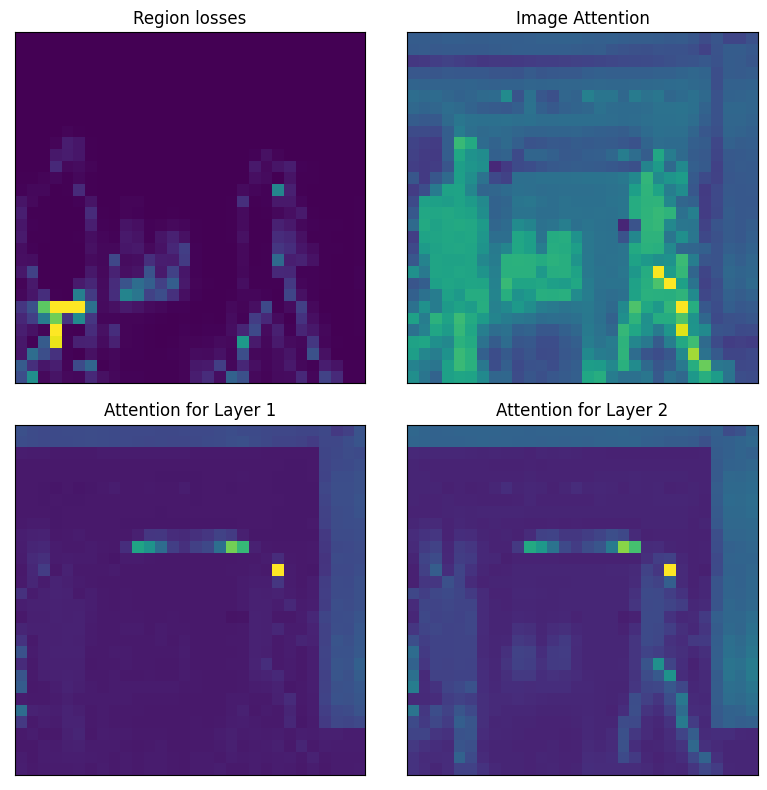

In [18]:
attention_display(430)

Region 16x16 losses


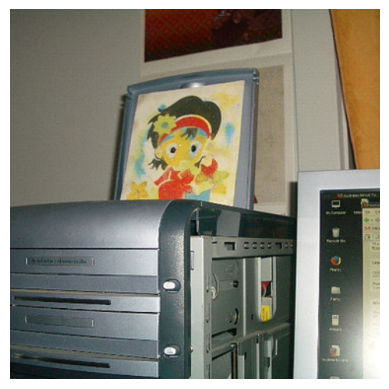

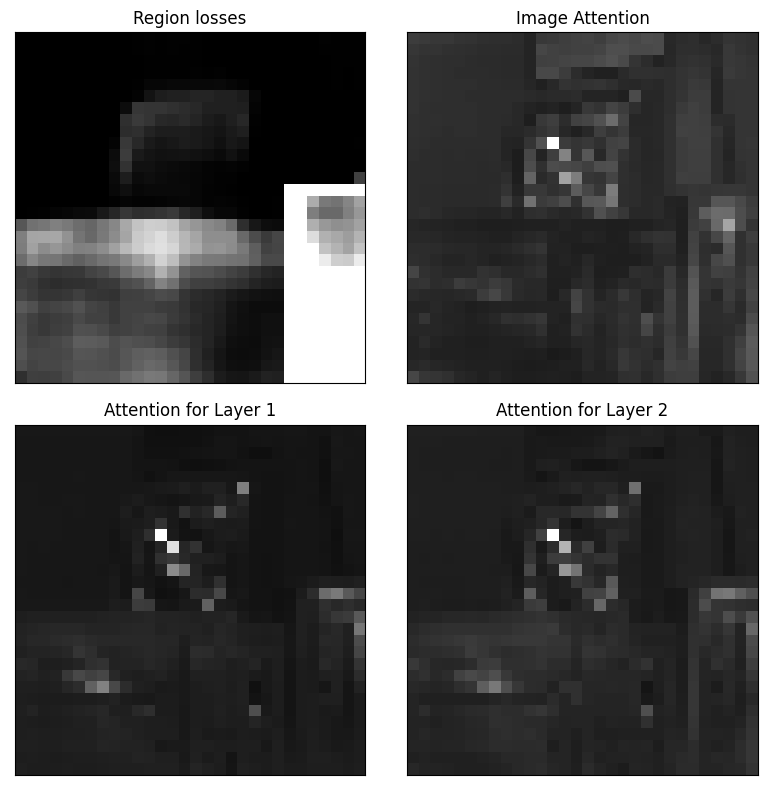

In [9]:
attention_display(450)

Region 16x16 losses


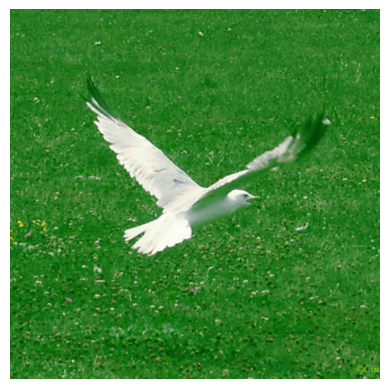

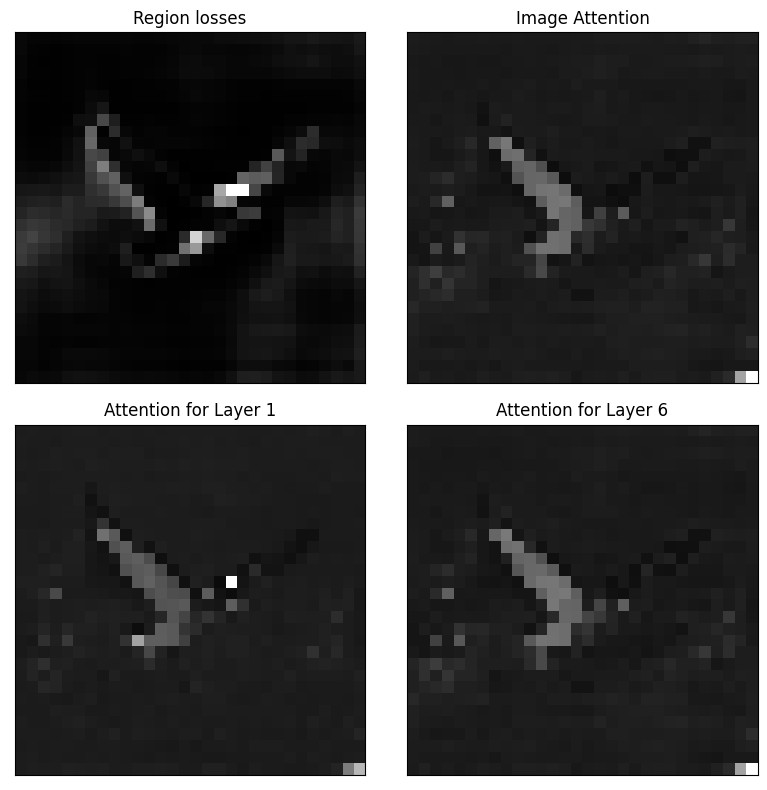

In [7]:
attention_display(397)

Region 16x16 losses


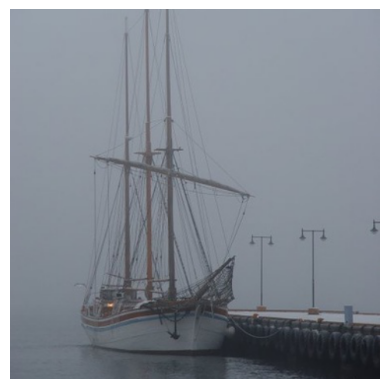

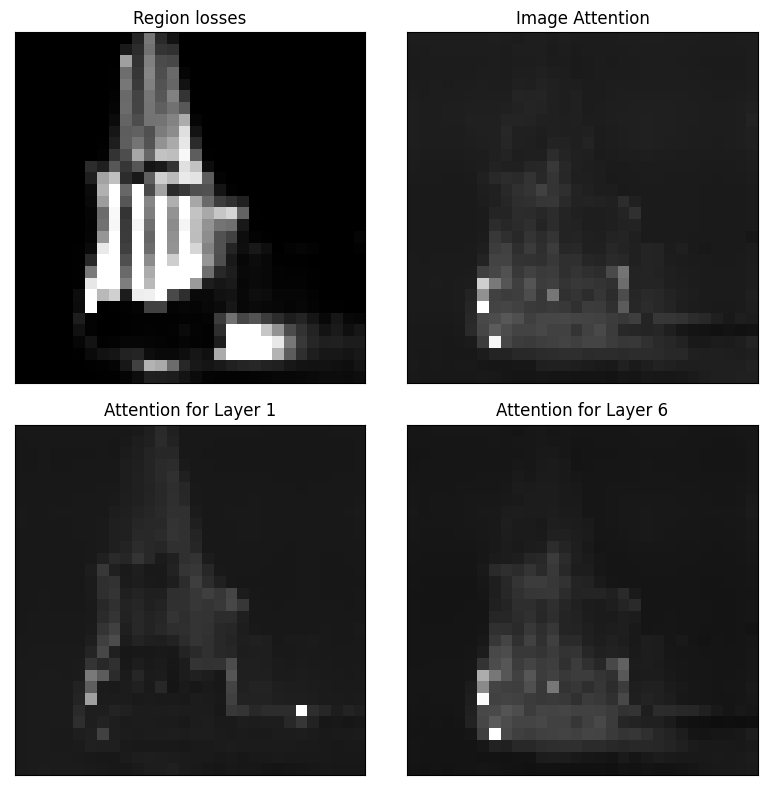

In [5]:
attention_display(184)

Region 16x16 losses


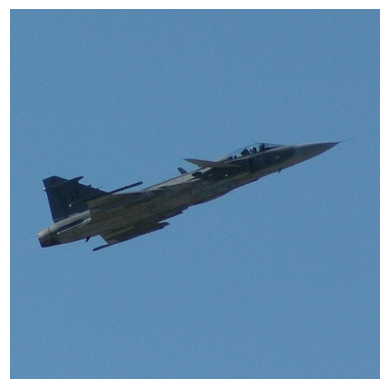

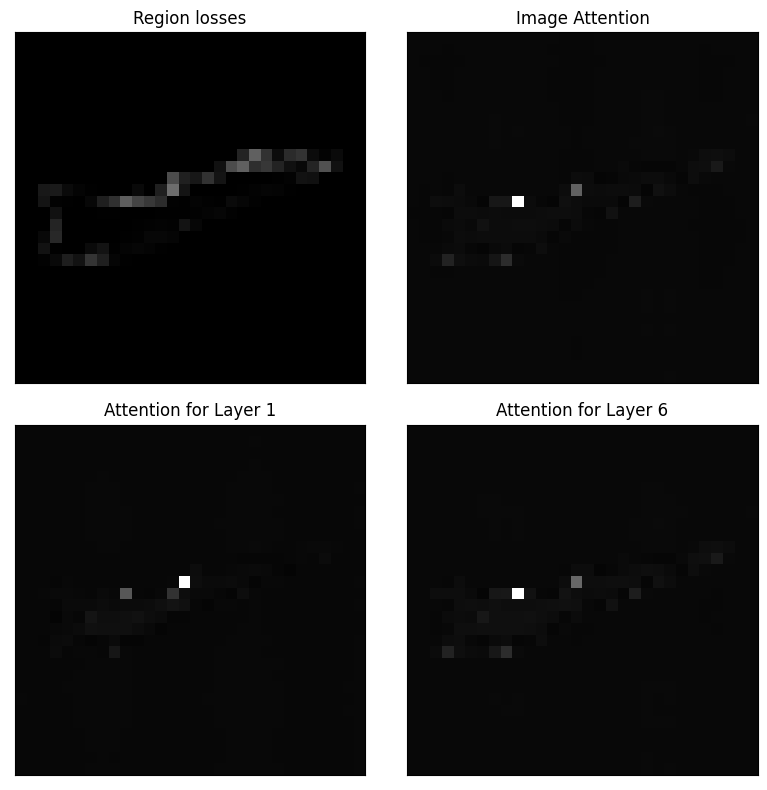

In [9]:
attention_display(318)

Region 16x16 losses


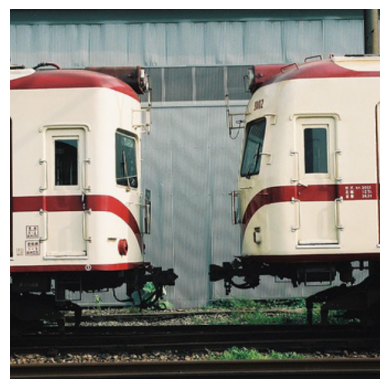

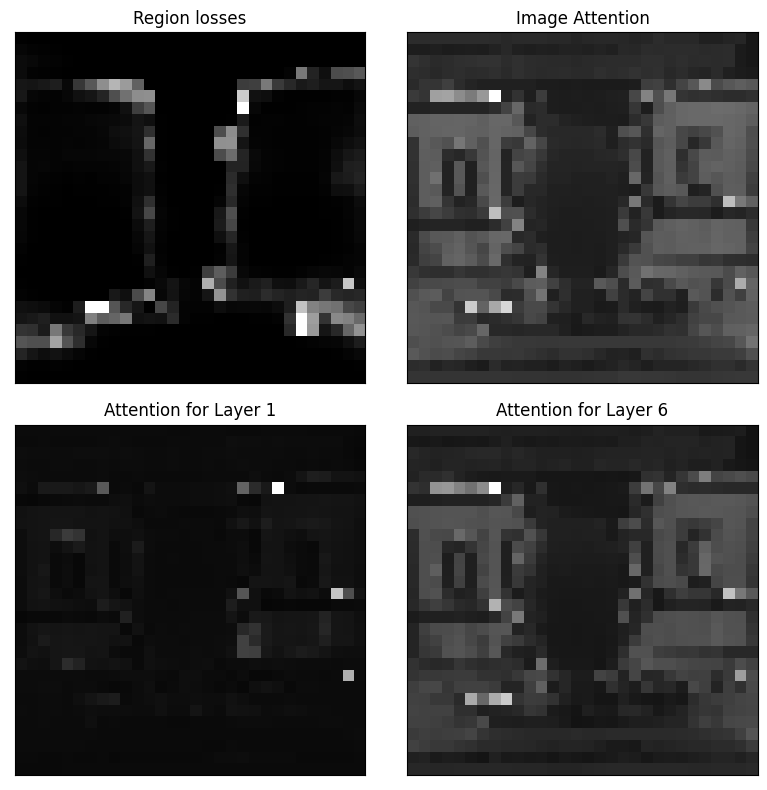

In [26]:
attention_display(1)

Region 16x16 losses


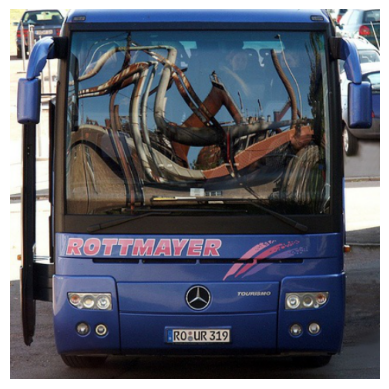

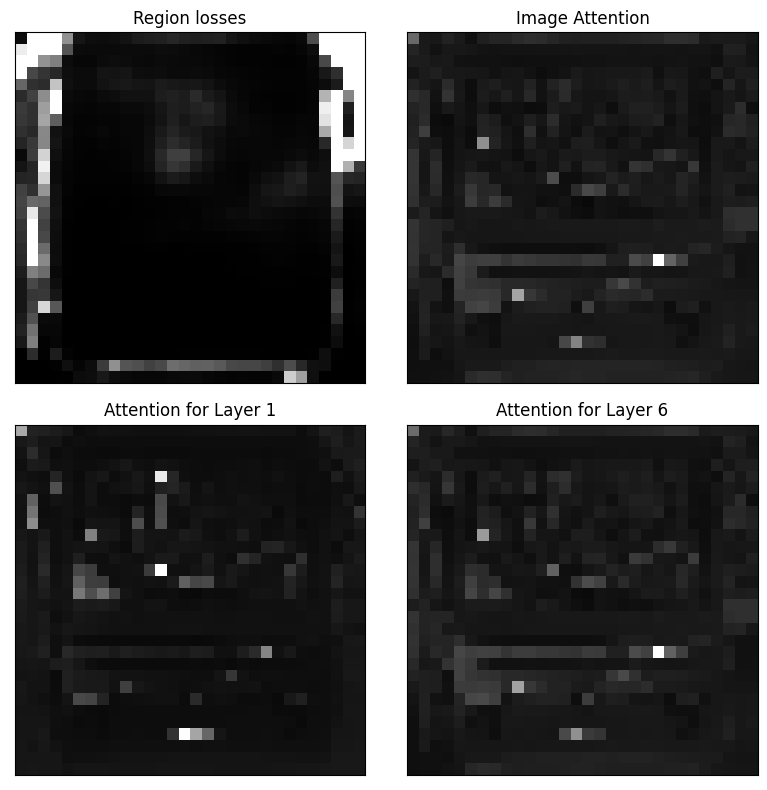

In [42]:
attention_display(19)

All losses


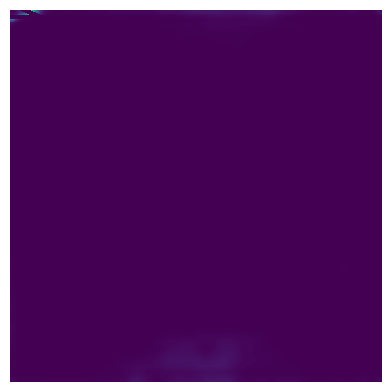

Region 16x16 losses


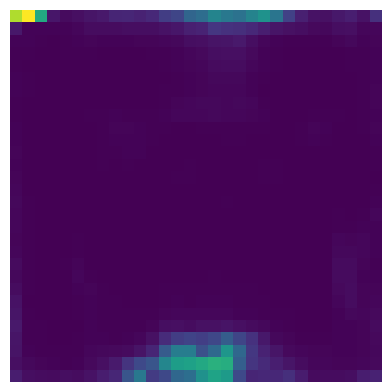

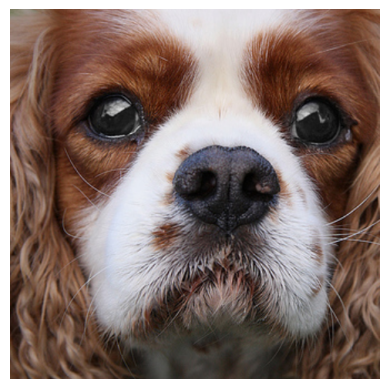

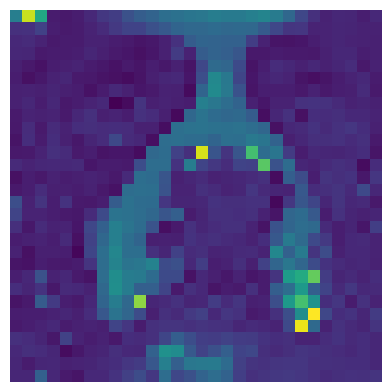

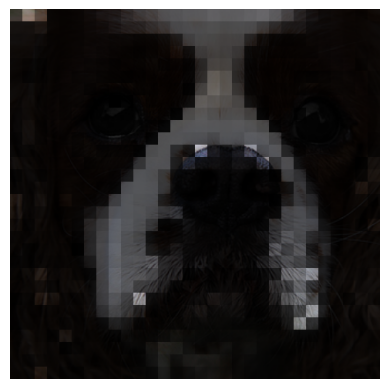

In [22]:
attention_display(689)

## Display image for overview figure

In [35]:
def attention_display(index, image_name, save = False):
    file_name = str(index//8) + ".npy"
    # one_result = np_read_with_tensor_output(feature_dir + file_name)
    # one_image = np_read_with_tensor_output(image_dir + file_name)
    image_index = index % 8
    # feature = one_result[image_index]
    # image = one_image[image_index]
    # feature = F.softmax(feature, dim=0)
    # feature[feature>0.99] = 1
    # feature[feature<0.01] = 0
    # feature_entropy = torch.sum(-feature * torch.log(feature + 1e-20), dim=0)
    # feature = torch.cat((image, feature), dim=0)
    feature, label = train_loader.__getitem__(index)
    logits, att_mat, patch_estimates = model(feature.unsqueeze(0))
    
    print("All losses")
    losses = np_read(loss_dir + file_name)[image_index]
    # plt.matshow(losses)
    # plt.axis('off')
    # # plt.colorbar()
    # if save:
    #     plt.savefig(f'./figure/loss_output_entropy_figures/{index}_all_losses.png', bbox_inches='tight', pad_inches=0)
    # plt.show()
    
    print("Region 16x16 losses")
    region_losses = torch.from_numpy(losses).unsqueeze(0)
    region_losses = avgpool(region_losses).numpy().squeeze()
    # , vmin=0, vmax=2
    plt.matshow(region_losses, vmin=0, vmax=5)
    plt.axis('off')
    # plt.colorbar()
    if save:
        plt.savefig(f'./figure/loss_output_entropy_figures/{index}_patch_losses.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    
    print("Estimate 16x16 losses")
    region_extimate_losses = patch_estimates.argmax(dim=2)
    region_extimate_losses = region_extimate_losses.reshape((30,30))
    
    plt.matshow(region_extimate_losses)
    plt.axis('off')
    if save:
        plt.savefig(f'./figure/loss_output_entropy_figures/{index}_estimated_patch_losses.png', bbox_inches='tight', pad_inches=0)
    plt.show()
    
    att_mat = torch.stack(att_mat).squeeze(1)

    # Average the attention weights across all heads.
    att_mat = torch.mean(att_mat, dim=1)

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1))
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)

    # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size())
    joint_attentions[0] = aug_att_mat[0]

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])

    # Attention from the output token to the input space.
    v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()

    # transform = transforms.Compose([
    #     transforms.Resize((224, 224)),
    #     transforms.ToTensor(),
    #     transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    # ])
    im = Image.open("/data/active_testing/active_testing_seg/datasets/PascalVOC/VOCdevkit/VOC2012/JPEGImages/" + image_name)
    
    # im_resize = im.resize((480,480))
    # im_resize.save(f"./figure/{index}_image.png")
    # plt.imshow(im_resize)
    # plt.axis('off')
    # plt.show()
    
    # x = transform(im)
    new_mask = cv2.resize(mask / mask.max(), im.size)[..., np.newaxis]
    new_mask = new_mask - new_mask.min()
    new_mask = new_mask / new_mask.max()
    result = (new_mask * im).astype("uint8")
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))

    # ax1.set_title('Original')
    # ax2.set_title('Attention Map')
    ax1.axis('off')
    ax2.axis('off')
    # im_resize = im.resize((480,480))
    # result_resize = result.resize((480,480))
    _ = ax1.imshow(im)
    _ = ax2.imshow(result)

    probs = torch.nn.Softmax(dim=-1)(logits)
    top5 = torch.argsort(probs, dim=-1, descending=True)
    print("Prediction Label and Attention Map!\n")

    for i, v in enumerate(joint_attentions):
        # Attention from the output token to the input space.
        mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()
        new_mask = cv2.resize(mask / mask.max(), im.size)[..., np.newaxis]
        result = (new_mask * im).astype("uint8")

        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
        ax1.set_title('Original')
        ax2.set_title('Attention Map_%d Layer' % (i+1))
        _ = ax1.imshow(im)
        _ = ax2.imshow(result)

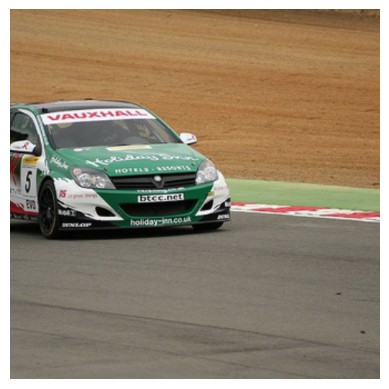

All losses
Region 16x16 losses


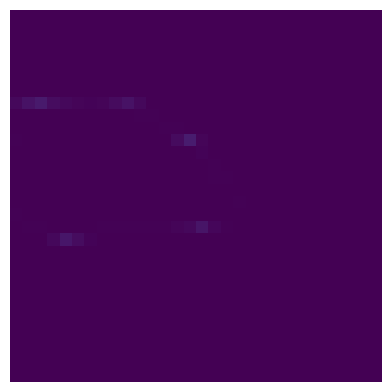

Estimate 16x16 losses


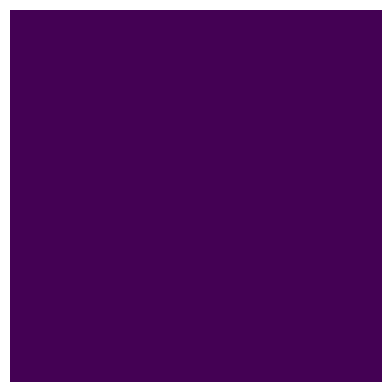

Prediction Label and Attention Map!



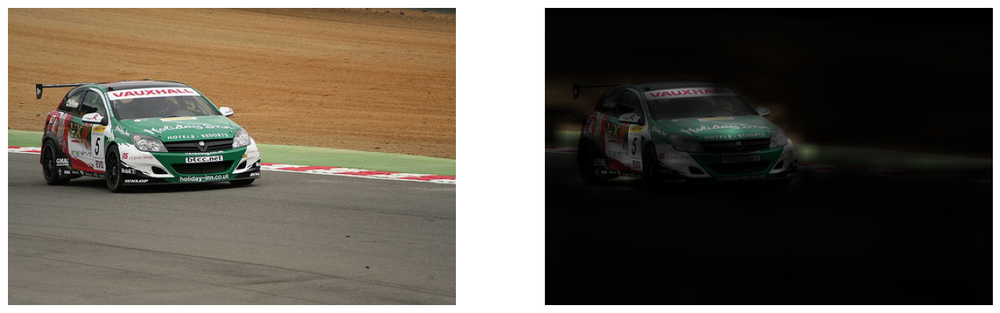

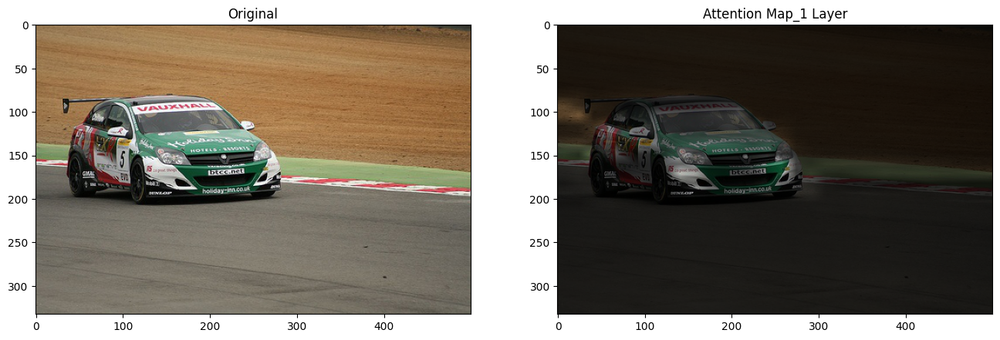

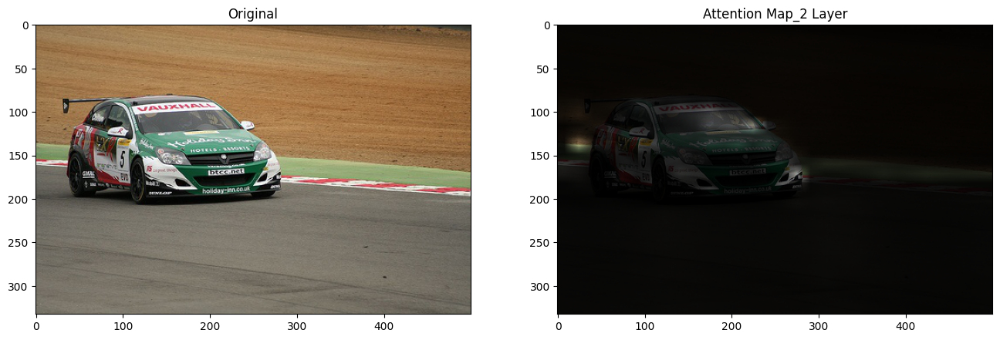

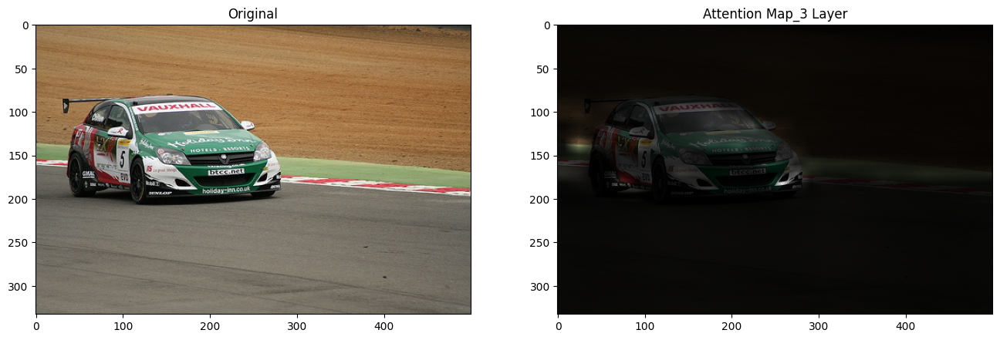

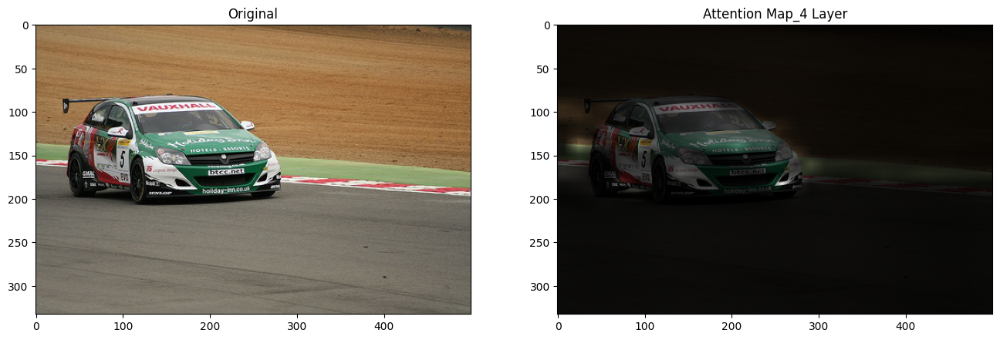

...

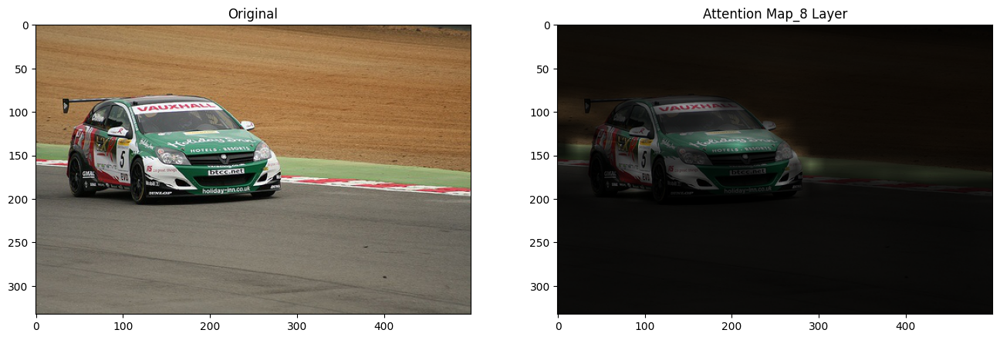

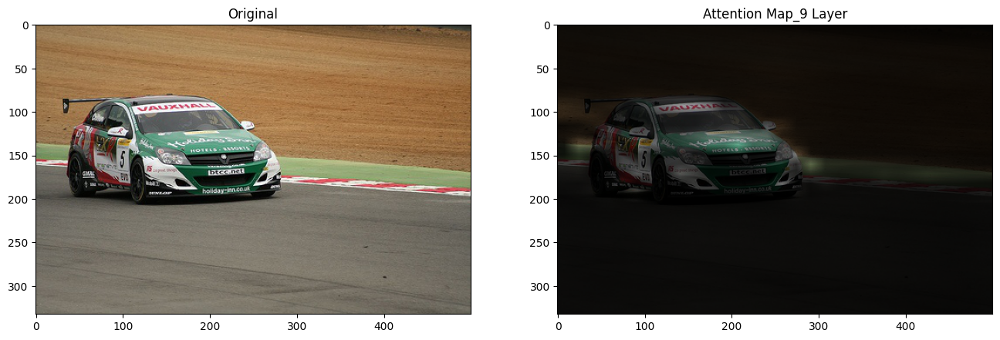

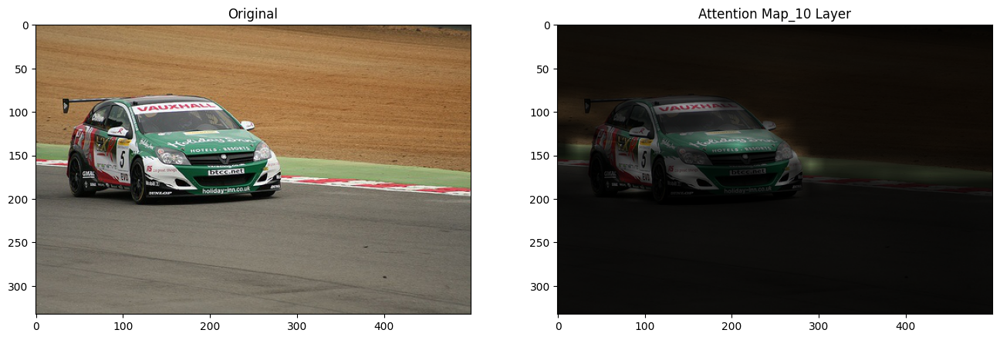

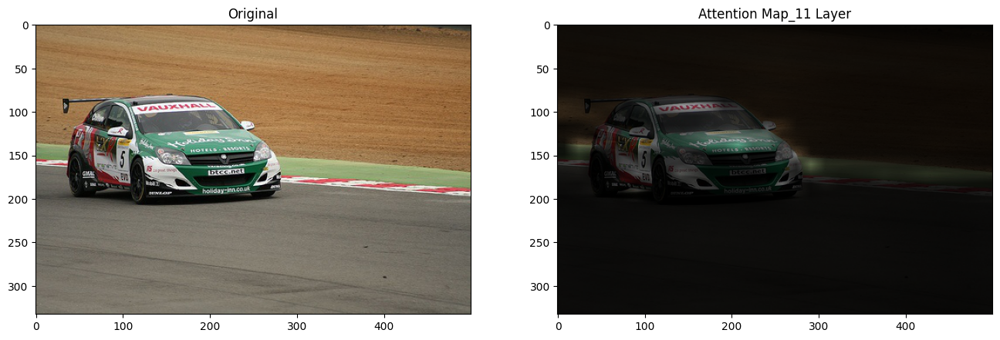

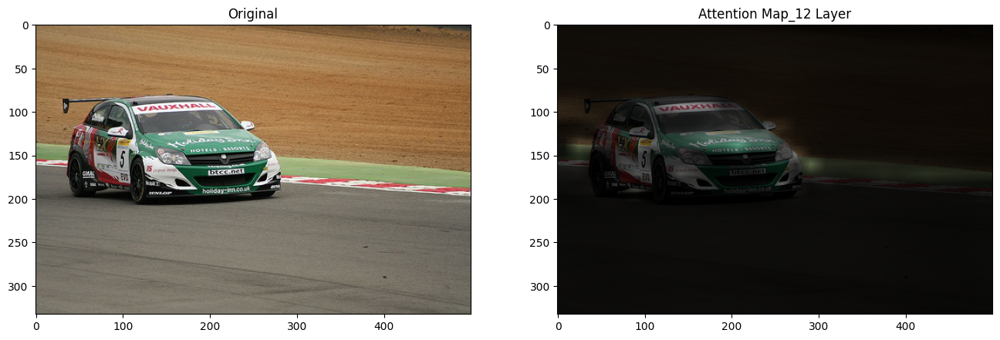

In [36]:
## PSPNet_VOC, 20000, 10, 20, 15 1 3
index = 97
display = True
# display_ground_truth_mask(index)
display_image(index, get_image_name_by_index(index), display)
# display_target_output_and_gt(index, display)
attention_display(index, get_image_name_by_index(index), display)

In [5]:
get_image_name_by_index(index)

'2011_003240.jpg'

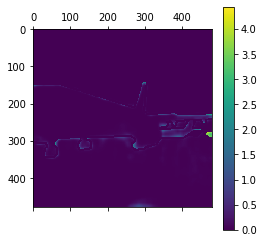

Prediction Label and Attention Map!



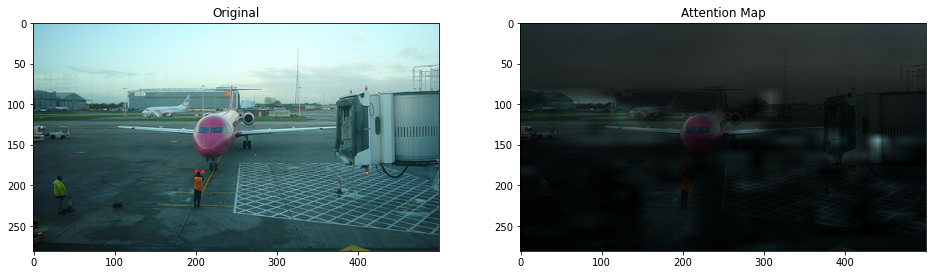

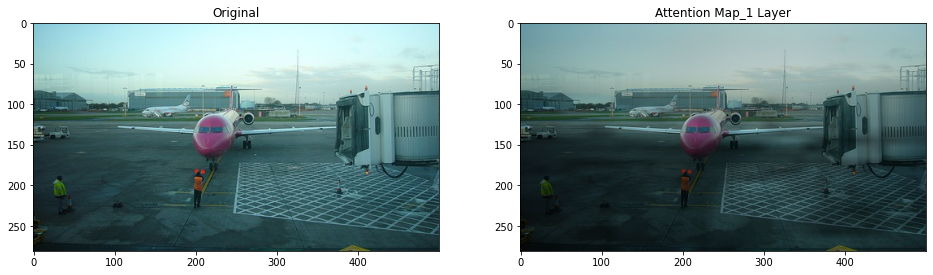

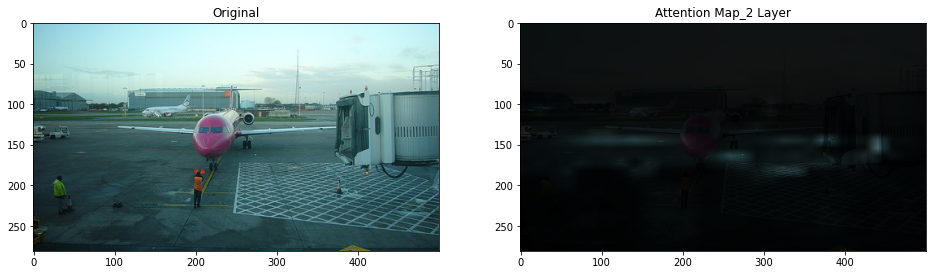

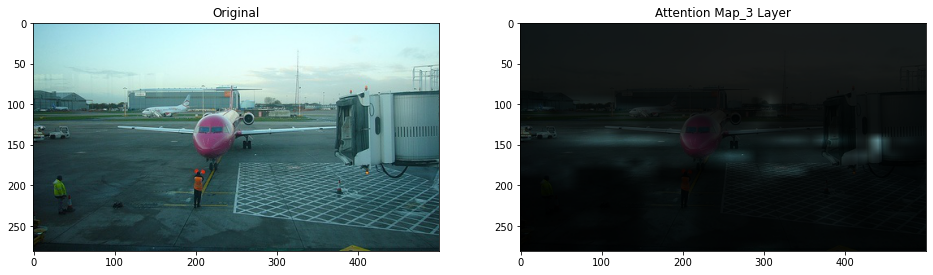

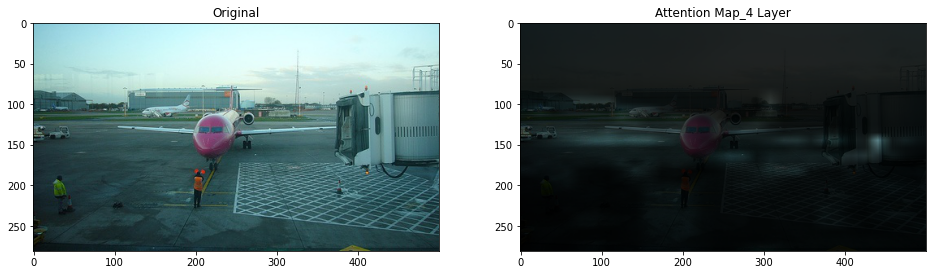

...

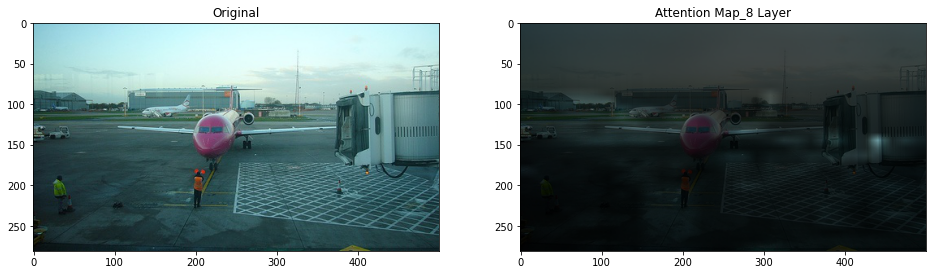

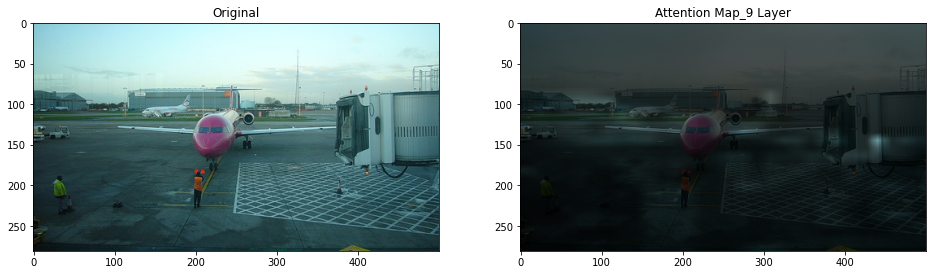

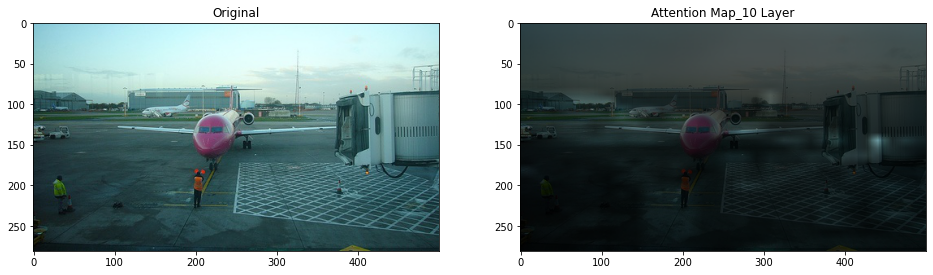

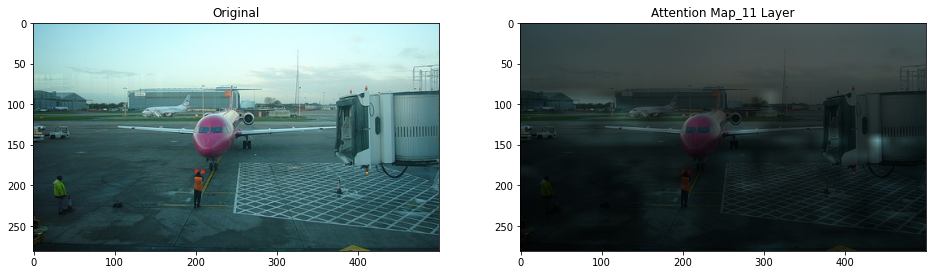

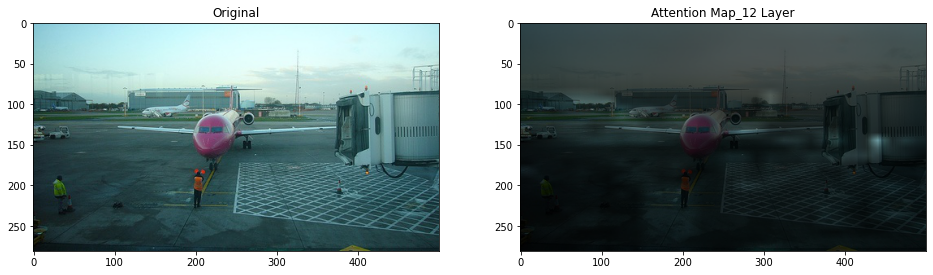

In [5]:
attention_display(0, "2007_000032.jpg")

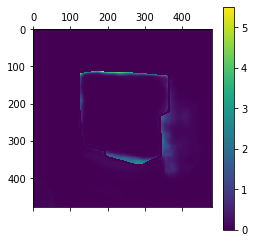

Prediction Label and Attention Map!



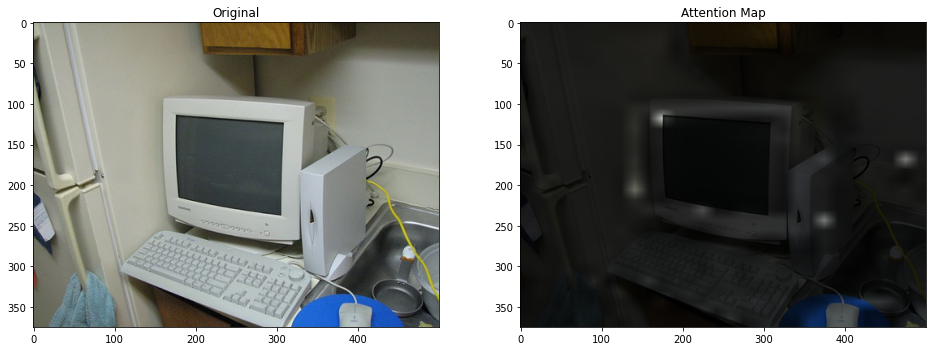

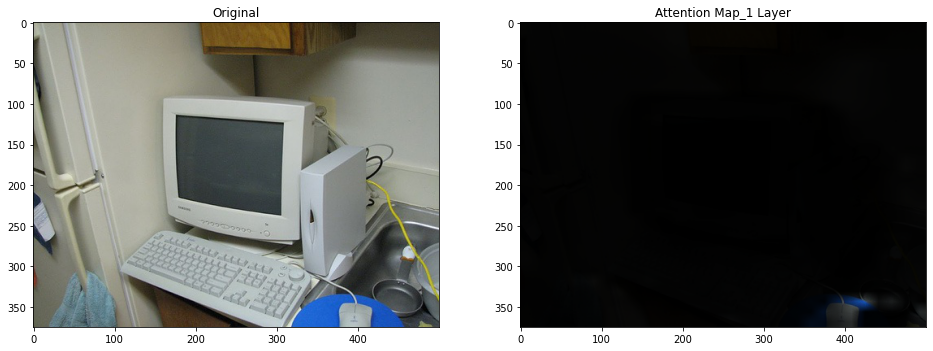

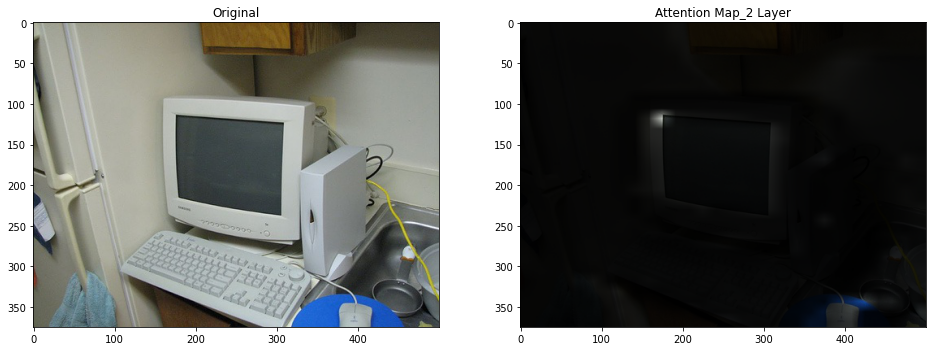

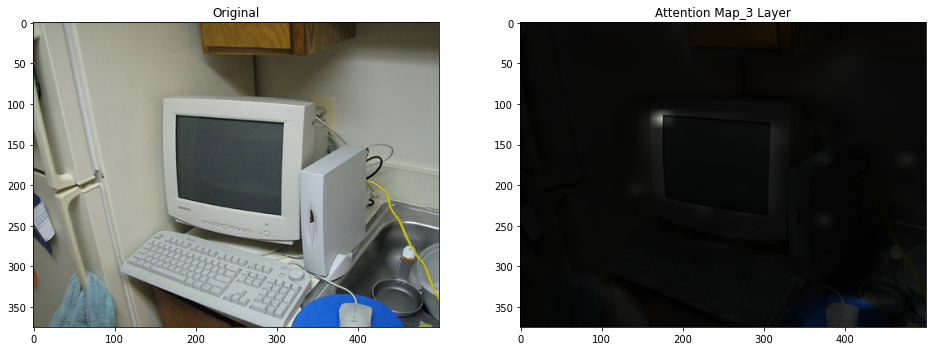

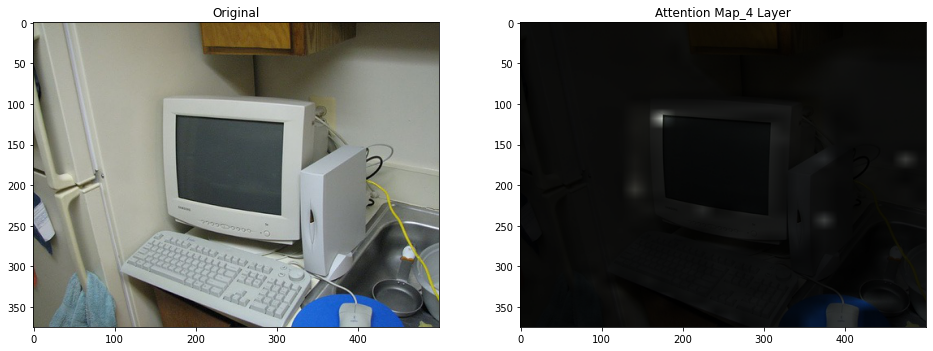

...

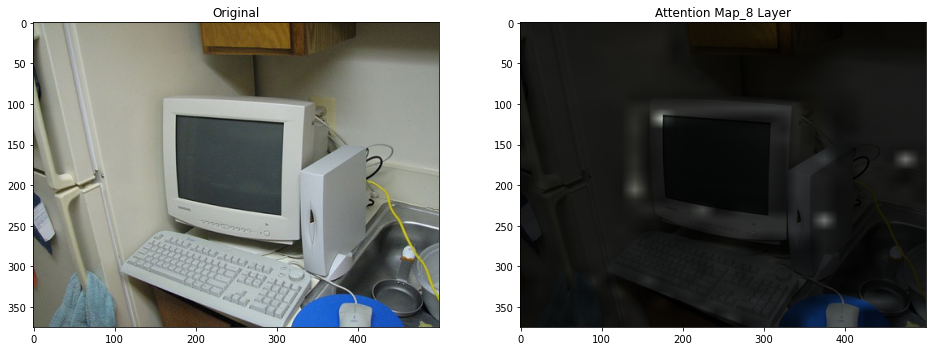

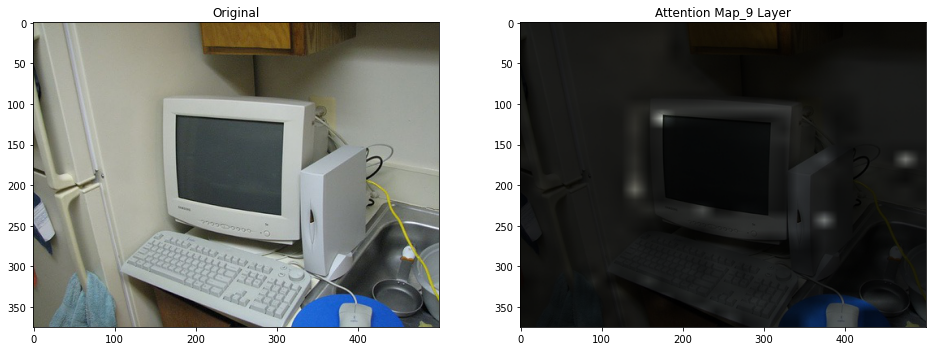

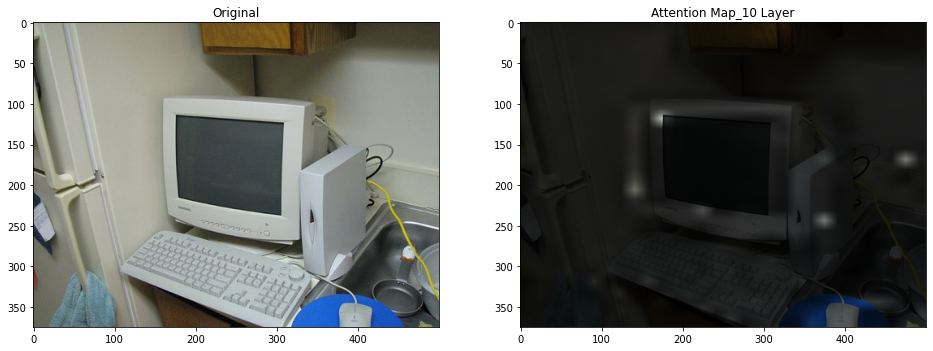

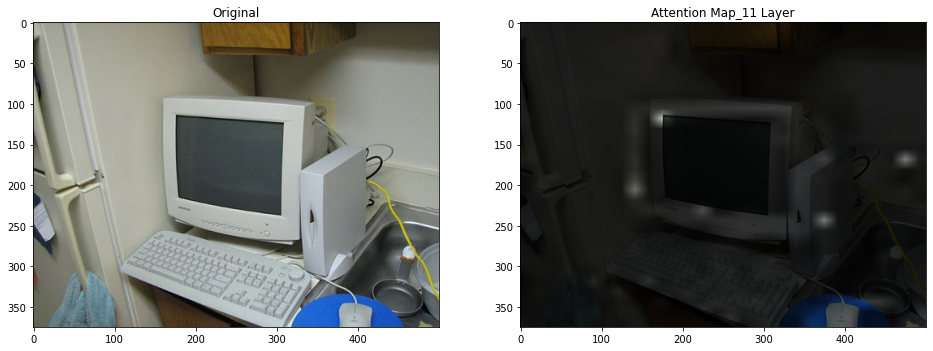

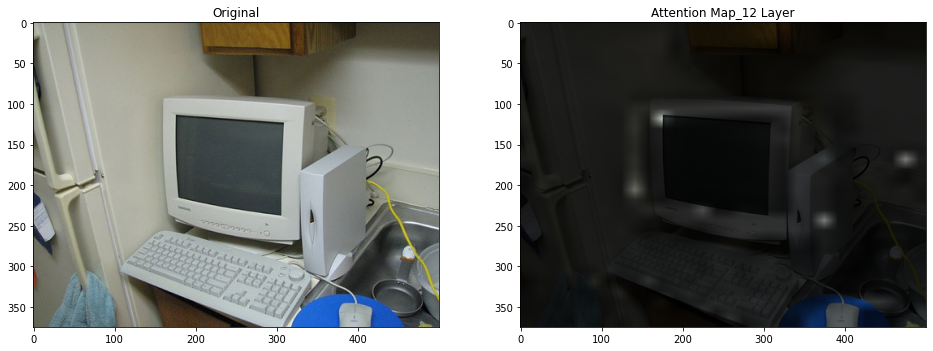

In [5]:
attention_display(1, "2007_000039.jpg")

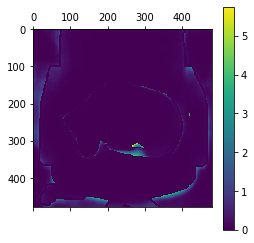

Prediction Label and Attention Map!



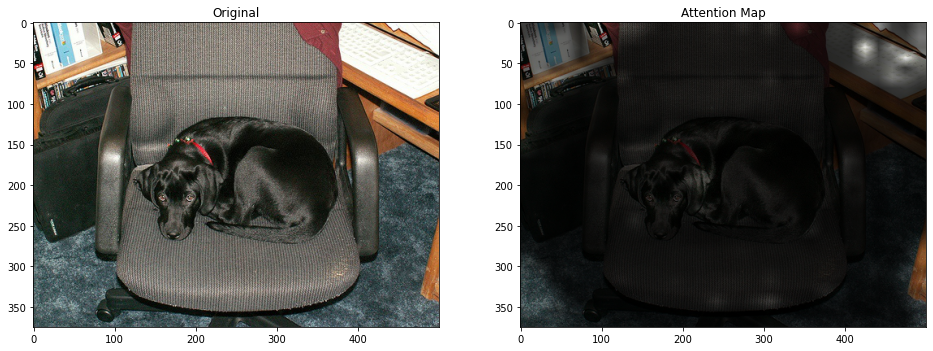

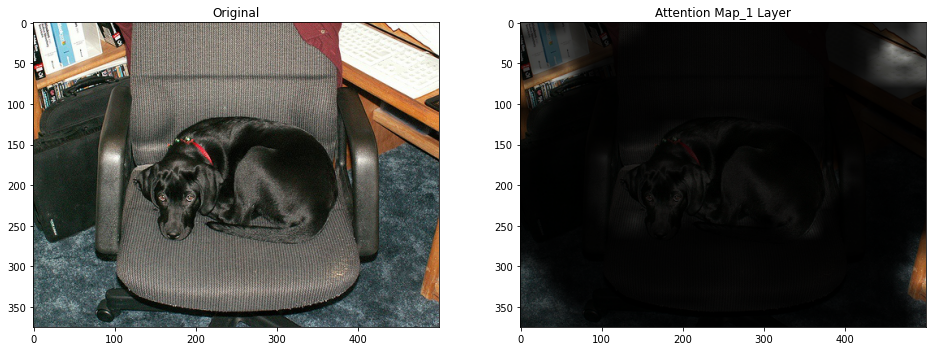

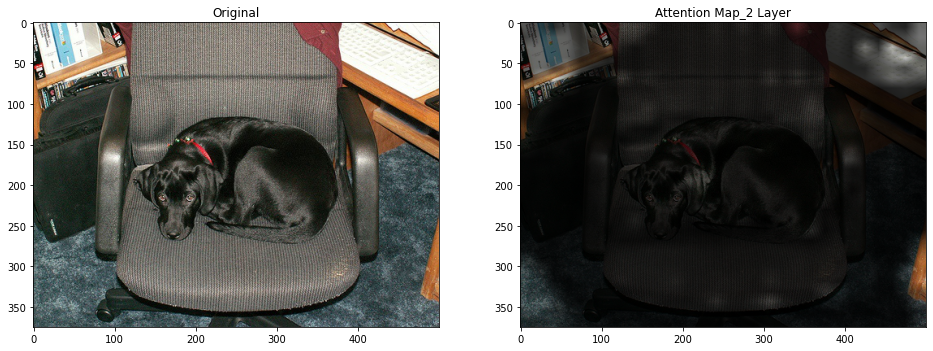

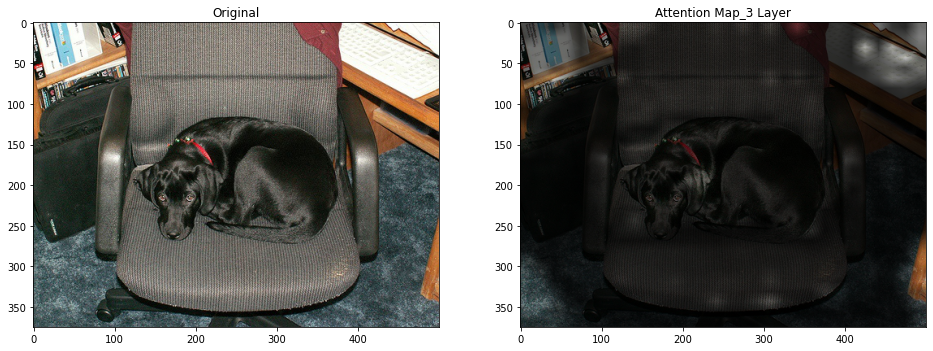

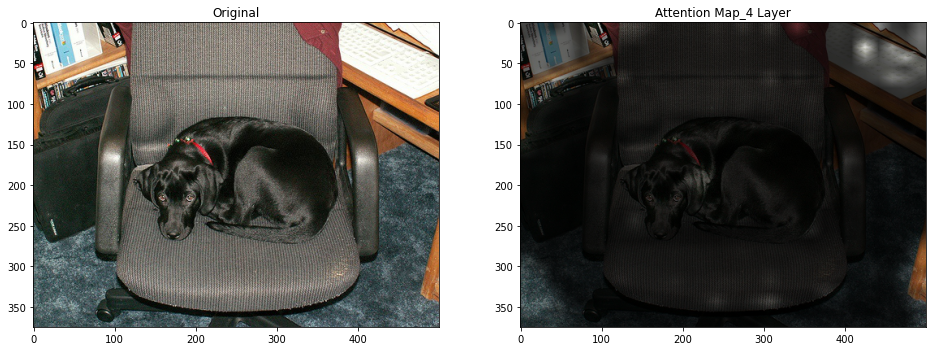

...

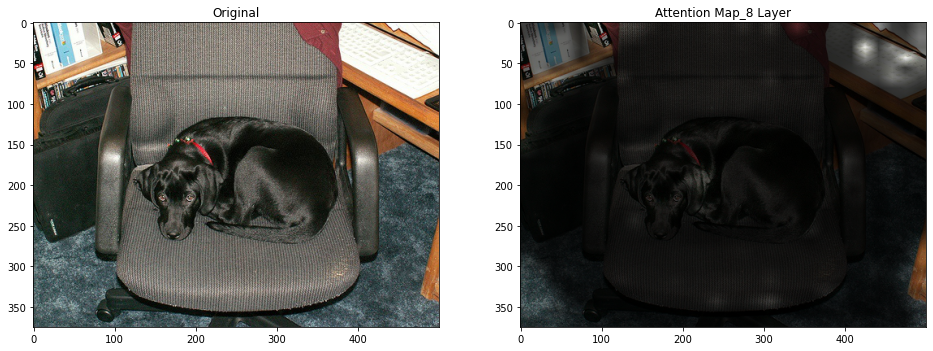

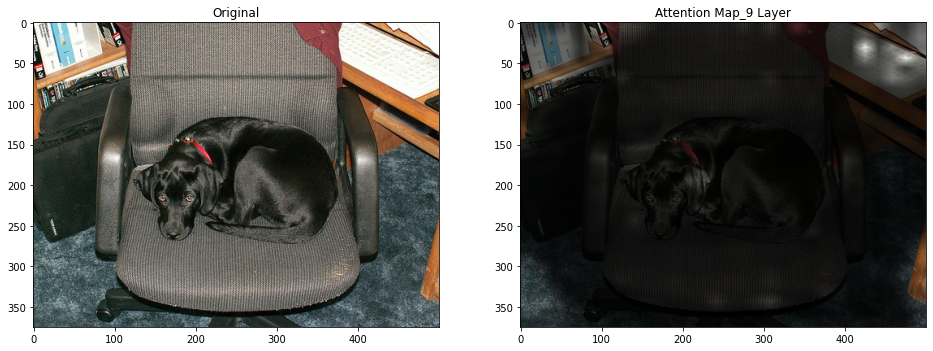

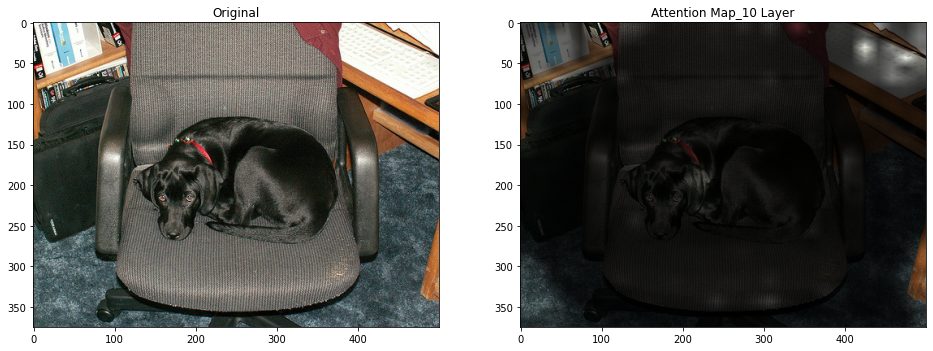

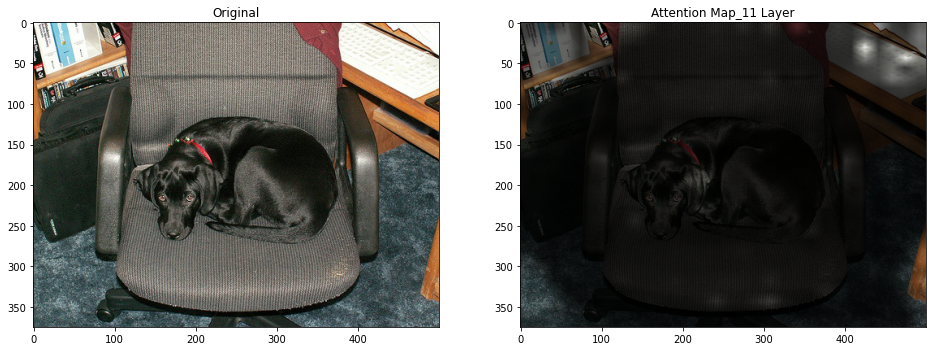

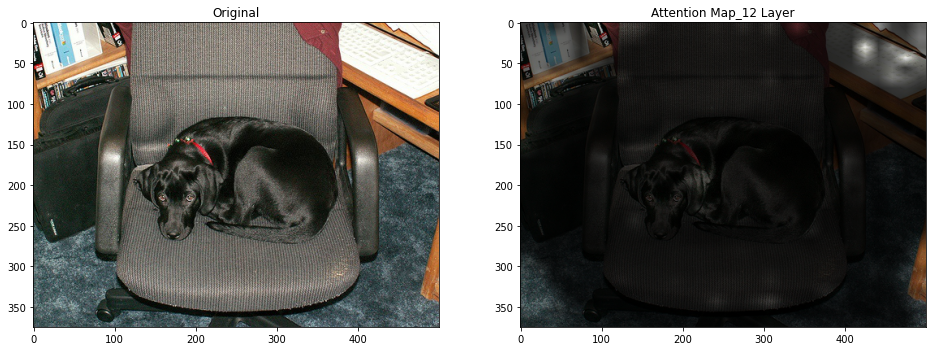

In [6]:
attention_display(2, "2007_000063.jpg")

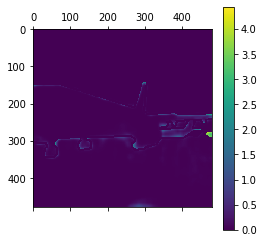

Prediction Label and Attention Map!



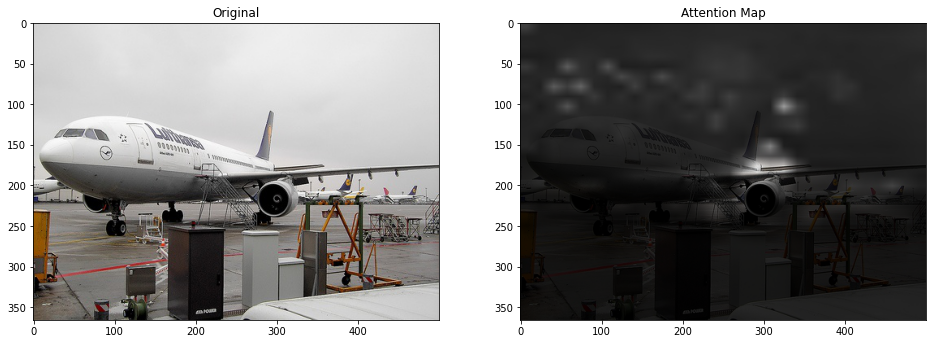

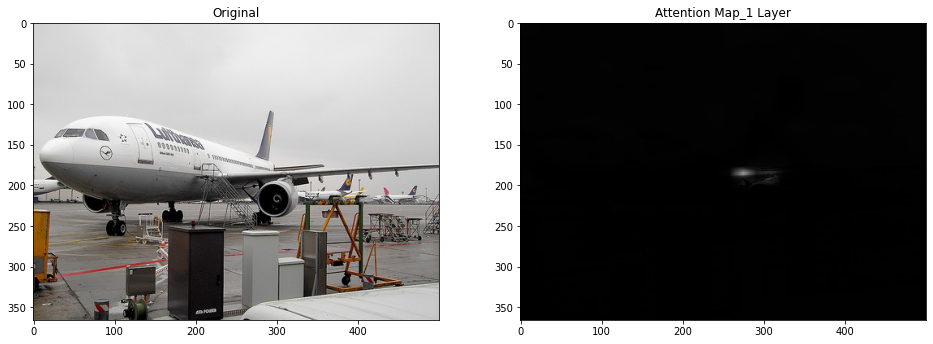

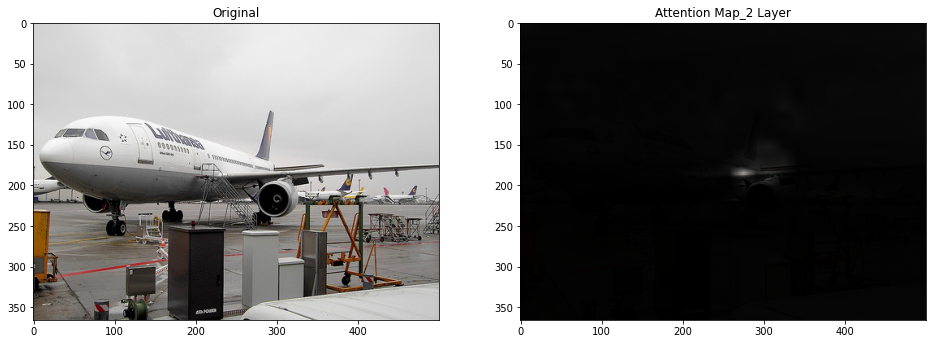

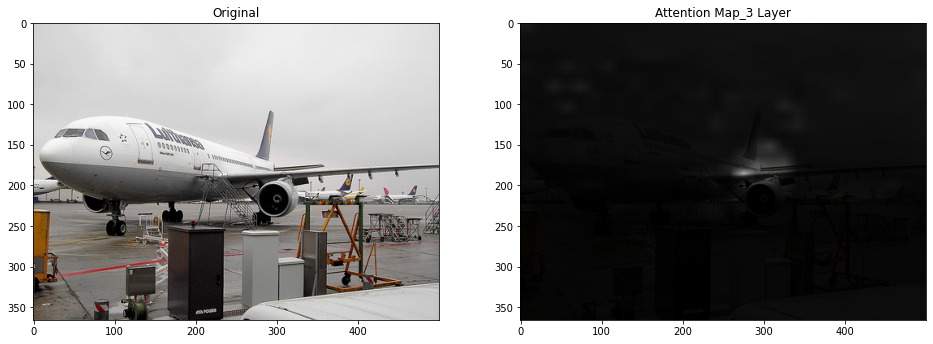

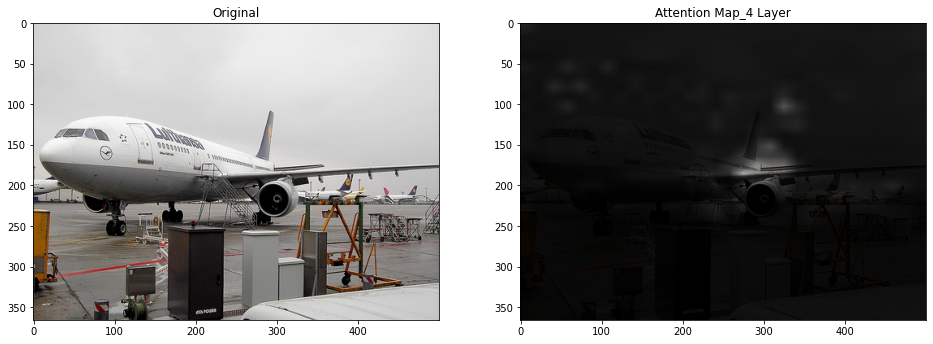

...

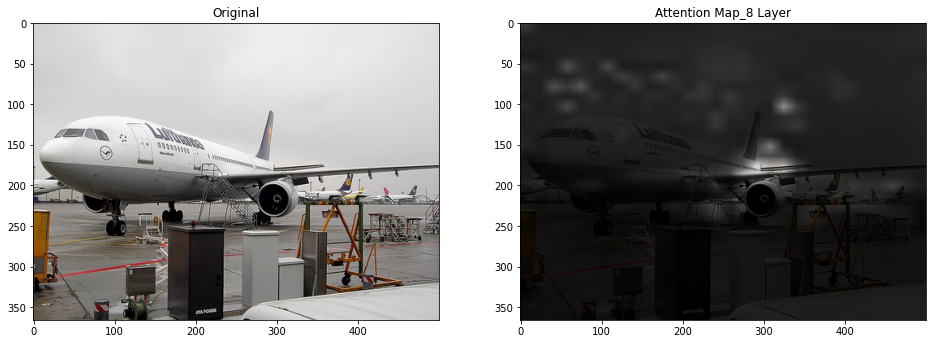

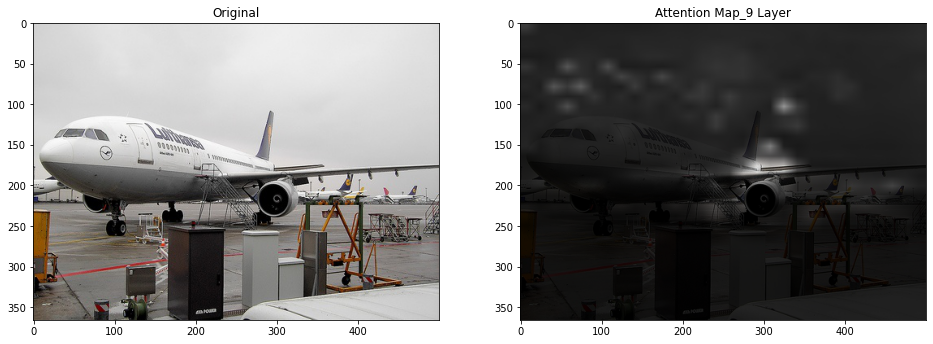

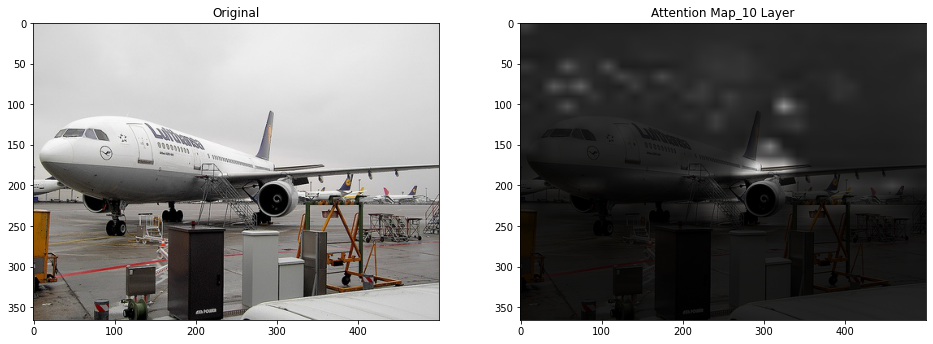

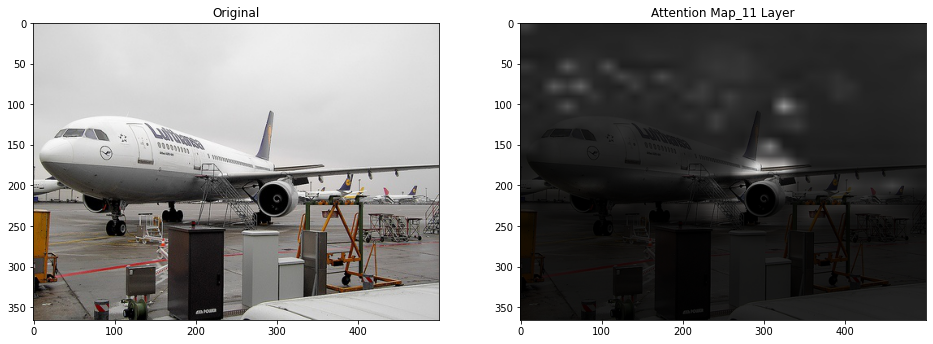

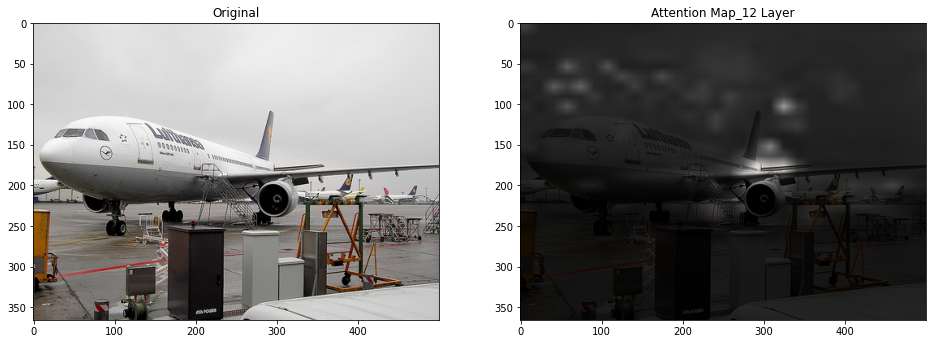

In [7]:
split = "val"
model_data_path = "/workspace/pytorch-segmentation/pro_data/PSPNet_VOC/"
feature_dir = model_data_path + split + "/output/"
image_dir = model_data_path + split + "/image/"
loss_dir = model_data_path + split + "/loss/"
attention_display(0, "2007_000033.jpg")

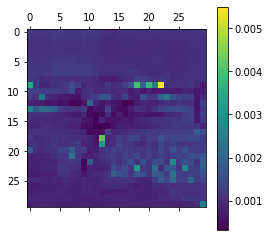

In [17]:
plt.matshow(mask)
plt.colorbar()
plt.show()

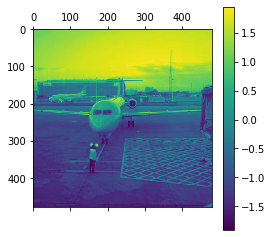

In [18]:
plt.matshow(feature[0])
plt.colorbar()
plt.show()

In [33]:
new_mask = mask/mask.max()
new_mask = np.repeat(np.repeat(new_mask, 16, axis=0), 16, axis=1)

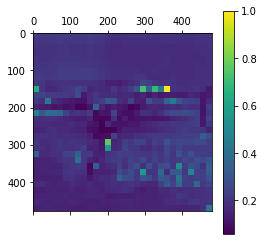

In [34]:
plt.matshow(new_mask)
plt.colorbar()
plt.show()

Prediction Label and Attention Map!



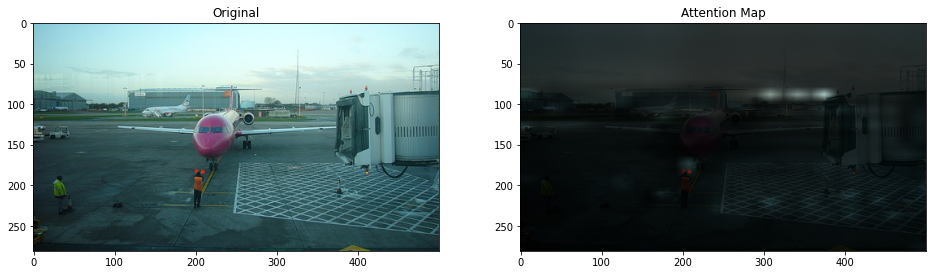

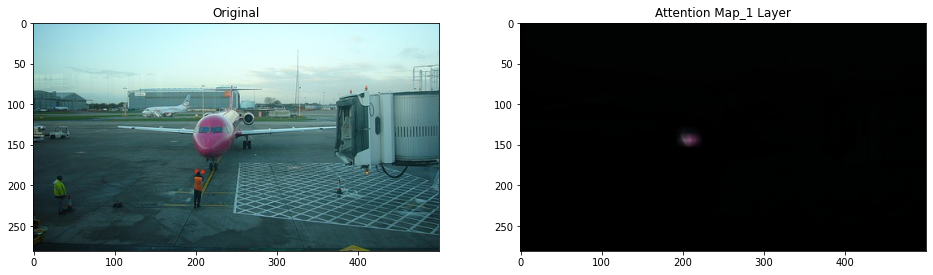

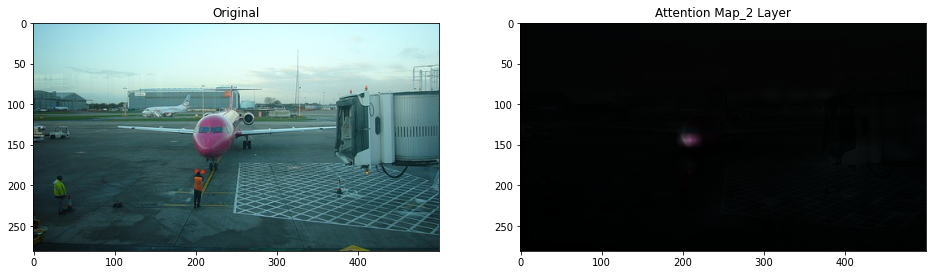

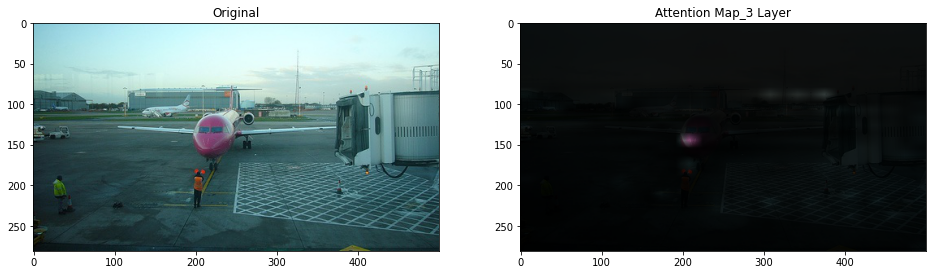

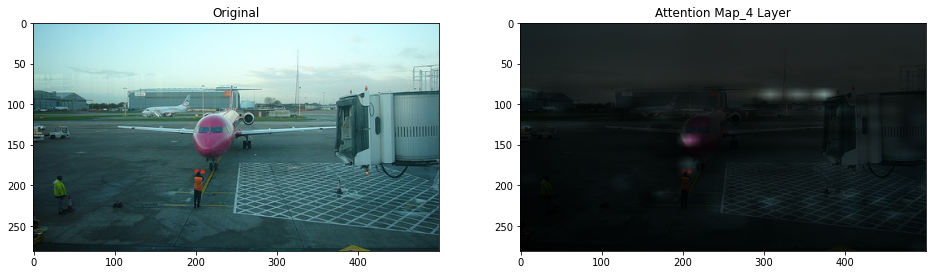

...

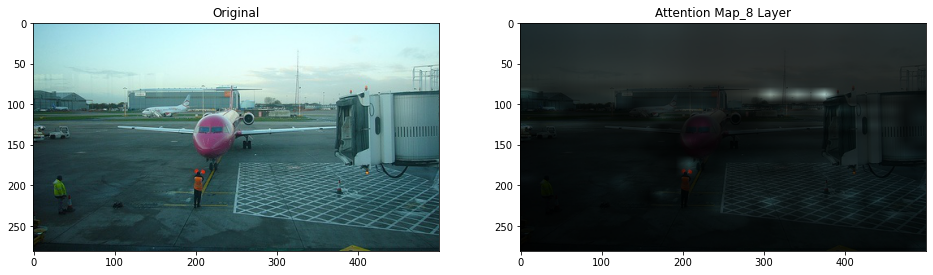

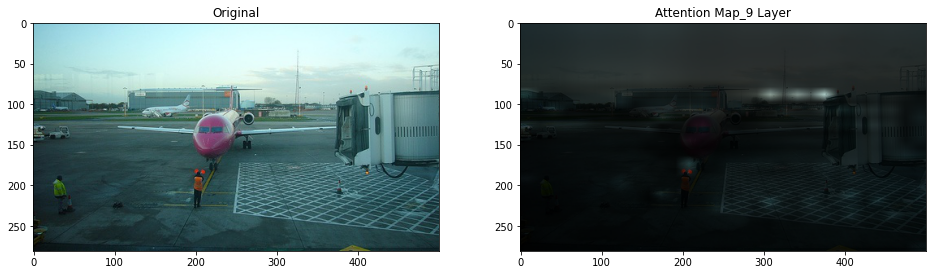

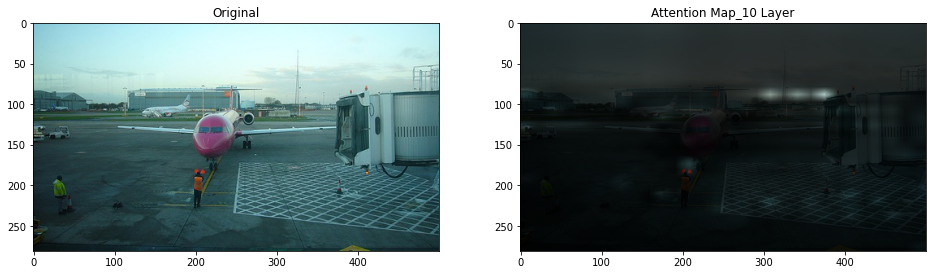

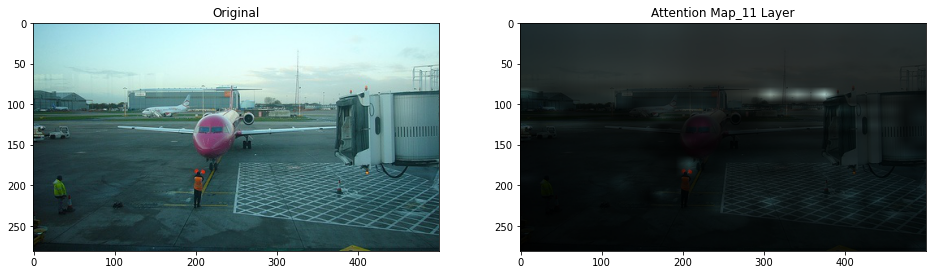

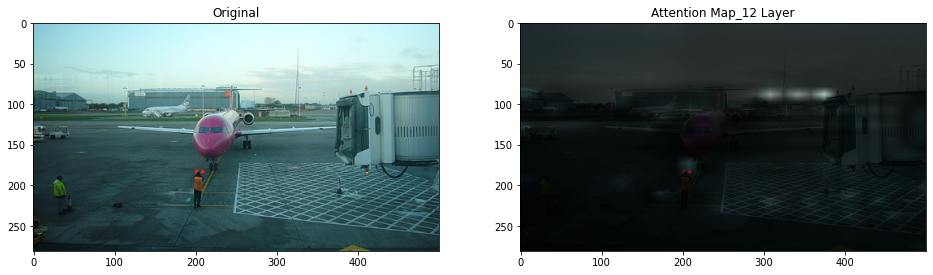